# Select data and import libraries

In [2]:
import sys # we require code from other folders
import pandas as pd
import numpy as np
import itertools
import pickle
import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt
CB_color_cycle = ['#EECC16', '#62BB35', '#FDAE33','#208EA3', '#EA4E9D', '#984ea3','#999999', '#e41a1c', '#dede00']

In [ ]:
import matplotlib.font_manager as fm
font_files = fm.findSystemFonts()

plt.rcdefaults()
# Go through and add each to Matplotlib's font cache.
for font_file in font_files:
    fm.fontManager.addfont(font_file)
plt.rc('font', family='Roboto')

In [61]:
plt.rc('font', family='Roboto')
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = 'Roboto'

In [62]:
%config InlineBackend.figure_format='retina'

In [63]:
# pytorch relates imports
import torch
import torch.nn as nn
import torch.optim as optim

# imports from captum library
from captum.attr import LayerDeepLift

In [64]:
# for combobox
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

In [65]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

In [66]:
pd.options.display.min_rows = 20000
pd.set_option('max_colwidth', 200)

In [67]:
pd.options.display.max_rows = 20000

In [68]:
pd.set_option('min_rows', 20000)

In [6]:
mac = "/Users/katyna/Library/CloudStorage/OneDrive-Tecnun/"
windows = "C:/Users/ksada/OneDrive - Tecnun/"
computer = mac # CHANGE

In [7]:
sys.path.append(computer + "SparseGO_code/code")
import util
from util import *

In [8]:
%matplotlib inline

In [9]:
# To make histograms
def histogram(dataframe, color, title, ylabel,n_bins):
    N, bins, patches = plt.hist(dataframe, color=color,bins=n_bins, linewidth=0.1)

    for i in range(0,len(bins)-1):
        if bins[i]<0.05:
            patches[i].set_facecolor(CB_color_cycle[2])

    plt.xlabel("P-value", fontsize=16)  
    plt.ylabel(ylabel, fontsize=16)
    plt.title(title, fontsize=16)
    plt.xticks(fontsize=14)  
    plt.yticks(fontsize=14)
    ax = plt.subplot(111)  
    ax.spines["top"].set_visible(False)  
    ax.spines["right"].set_visible(False)    

In [10]:
inputdir = computer+"SparseGO_code/data/train_sparseGO/allsamples/" # CHANGE
dir1=computer+"Tesis/Codigo/VariableImportance/"
dir2=computer+"SparseGO_code/results/weights&biases/SparseGO_Standard_Expression/samples1/" # CHANGE
resultsdir=dir2

In [11]:
gene2id = inputdir+"gene2ind.txt"
cell2id=inputdir+"cell2ind.txt"
drug2id=inputdir+"drug2ind.txt"
drug2fingerprint=inputdir+"drug2fingerprint.txt"
load=resultsdir+"last_model.pt"

onto = inputdir+"sparseGO_ont.txt"  # CHANGE 
genotype=inputdir+"cell2expression.txt"  # CHANGE 

num_neurons_per_GO = 6 # CHANGE

# DeepLIFT

In [12]:
gene2id_mapping = load_mapping(gene2id)
dG, terms_pairs, genes_terms_pairs = load_ontology(onto, gene2id_mapping)
sorted_pairs, level_list, level_number = sort_pairs(genes_terms_pairs, terms_pairs, dG, gene2id_mapping)
layer_connections = pairs_in_layers(sorted_pairs, level_list, level_number) 

cell_features = np.genfromtxt(genotype, delimiter=',')
drug_features = np.genfromtxt(drug2fingerprint, delimiter=',')

drug2id_mapping = load_mapping(drug2id)
cell2id_mapping = load_mapping(cell2id)

num_genes = len(gene2id_mapping)
drug_dim = len(drug_features[0,:])

There are 14457 genes
There are 1 roots: GO:0008150
There are 4840 terms
There are 1 connected components


In [13]:
#model = torch.load(load, map_location='cuda:%d' % 0)
model = torch.load(load, map_location=torch.device('cpu'))

In [14]:
model

sparseGO_nn(
  (genes_terms_sparse_linear_1): SparseLinearNew(
    in_features=14457, out_features=29040, bias=True, sparsity=0.001853544595343158, connectivity=tensor([[ 3102,  3103,  3104,  ..., 24099, 24100, 24101],
            [    0,     0,     0,  ..., 14456, 14456, 14456]]), small_world=False
  )
  (genes_terms_batchnorm): BatchNorm1d(14457, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (genes_terms_tanh): Tanh()
  (drop_0): Dropout(p=0.15, inplace=False)
  (GO_terms_sparse_linear_1): SparseLinearNew(
    in_features=29040, out_features=13656, bias=True, sparsity=0.0010022839837906142, connectivity=tensor([[    0,     1,     2,  ...,  5367,  5368,  5369],
            [    0,     0,     0,  ..., 29039, 29039, 29039]]), small_world=False
  )
  (drop_1): Dropout(p=0.15, inplace=False)
  (GO_terms_tanh_1): Tanh()
  (GO_terms_batchnorm_1): BatchNorm1d(29040, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (GO_terms_sparse_linear_2): SparseLinearN

In [15]:
# Save layers to be analyzed
model_layers = []
model_layers.append(model.genes_terms_sparse_linear_1)
model_layers.append(model.GO_terms_sparse_linear_1)
model_layers.append(model.GO_terms_sparse_linear_2)
model_layers.append(model.GO_terms_sparse_linear_3)
model_layers.append(model.GO_terms_sparse_linear_4)
model_layers.append(model.GO_terms_sparse_linear_5)
model_layers.append(model.GO_terms_sparse_linear_6)
model_layers.append(model.GO_terms_sparse_linear_7)

## GO terms info

In [16]:
# Go term names
gene_ontology = pd.read_excel('all_go_terms_info.xlsx')
gene_ontology = gene_ontology.drop_duplicates(subset=['id'])

Get all layers' GO term with the neuron number

In [17]:
all_terms_ids = {}
all_terms_names = {}
all_layers_non_virtual = {} # store only terms that are part of the layer (remove virtual), those are the important attribuitions
all_layers_non_virtual_names = {}
num_neurons_per_GO = 6

for layer_number in range(len(layer_connections)-1):
    layer_pairs = layer_connections[layer_number] 
    
    terms_ids = []
    names = []
    output_id = create_index(layer_pairs[:,0]) # first 6 neurons correspond to the term with key 0
    # all_terms_ids IS CREATED IN THE SAME GO TERM ORDER IN WHICH THE CORRESPONDING NETWORK LAYER WAS CREATED (when calculating the XAI score, this lets us know which GO term it corresponds to).
    for term in output_id.keys():
        #name = gene_ontology.loc[gene_ontology['GO_term'] == term].to_numpy()[0,3].replace("_"," ").capitalize()
        name = gene_ontology.loc[gene_ontology['id'] == term].to_numpy()[0,1].capitalize()
        for i in range(1,num_neurons_per_GO+1): # vector que tiene GO:0000038_1, GO:0000038_2 ... GO:0000038_6 y asi luego concatenar con las attributions
            terms_ids.append(term+"_"+str(i))
            names.append(name+" ("+str(i)+")")
    all_terms_ids[layer_number] = np.array(terms_ids)
    all_terms_names[layer_number] = np.array(names)

    non_virtual = [] # store the terms part of that layer
    non_virtual_names = []
    for term in level_list[layer_number+1]:
        nv_name = gene_ontology.loc[gene_ontology['id'] == term].to_numpy()[0,1].capitalize()
        for i in range(1,7):
            non_virtual.append(term+"_"+str(i))
            non_virtual_names.append(nv_name+" ("+str(i)+")")
    all_layers_non_virtual[layer_number] = non_virtual
    all_layers_non_virtual_names[layer_number] = non_virtual_names

All GO terms part of a layer (non-virtual) with their corresponding name and layer number...

In [18]:
real_go_info = pd.DataFrame({"GO_term":[],"Name":[],"layer_number":[]})
for layer_number in range(len(layer_connections)-1):
    layer_go_info = pd.DataFrame({"GO_term":all_layers_non_virtual[layer_number],"Name":all_layers_non_virtual_names[layer_number],"layer_number":(layer_number)})
    real_go_info = pd.concat((real_go_info,layer_go_info))
real_go_info.head()

,GO_term,Name,layer_number
0,GO:0006264_1,Mitochondrial dna replication (1),0.0
1,GO:0006264_2,Mitochondrial dna replication (2),0.0
2,GO:0006264_3,Mitochondrial dna replication (3),0.0
3,GO:0006264_4,Mitochondrial dna replication (4),0.0
4,GO:0006264_5,Mitochondrial dna replication (5),0.0


## Drugs info

In [19]:
def get_compound_names(file_name):
    compounds = []

    with open(file_name, 'r') as fi:
        for line in fi:
            tokens = line.strip().split('\t')
            compounds.append([tokens[1],tokens[2]])
    return compounds

In [20]:
drugs = get_compound_names(inputdir+"compound_names.txt")
drugs.pop(0)

['SMILE', 'Name']

## DeepLIFT for VNN

*Reference activation...* (baseline)

In [21]:
median_cell_features = np.median(cell_features,axis=0) # to use as a reference
median_drug_features = np.genfromtxt(computer+"SparseGO_code/data/glucose_fingerprint.txt", delimiter=',')

### Attribution function: sum

In [22]:
def get_layer_attribution(layer_number,input_data,baseline,selected_drug_data):
    dl = LayerDeepLift(model, model_layers[layer_number],multiply_by_inputs = True) # CHOOSE LAYER TO STUDY
    dl_attr_test = dl.attribute(input_data,baseline)
    dl_attr_test_sum = dl_attr_test.cpu().detach().numpy().sum(0) # the attributions are summed for each sample
    
    # all_terms_ids WAS CREATED IN THE SAME GO TERM ORDER IN WHICH THE CORRESPONDING NETWORK LAYER WAS CREATED (when calculating the XAI score, this lets us know which GO term it corresponds to).
    attribution_data = pd.DataFrame(np.column_stack((all_terms_ids[layer_number],dl_attr_test_sum)), columns=["GO_term",selected_drug_data[1]])
    attribution_data[[selected_drug_data[1]]] = attribution_data[[selected_drug_data[1]]].apply(pd.to_numeric).round(10)
    attribution_data = attribution_data.loc[attribution_data['GO_term'].isin(all_layers_non_virtual[layer_number])] # only the keep the non virtual terms
    return attribution_data

### DeepLIFT for all drugs

In [ ]:
attribution_data_all = pd.DataFrame()
# Obtain the top GO terms on all layers for each drug
for selected_drug_data in drugs:
    selected_drug =selected_drug_data[0] # DRUG smile
    selected_drug_features = []
    drug_specific_features=drug_features[drug2id_mapping[selected_drug]] # features of drug
    
    for i in range(len(cell2id_mapping)): # make all combinations of selected_drug and cell types 
        selected_drug_features.append(np.concatenate((cell_features[i], drug_specific_features), axis=None))
    selected_drug_features = torch.FloatTensor(np.array(selected_drug_features))

    # Data for deeplift...
    input_data = torch.autograd.Variable(selected_drug_features.cuda(0))
    
    # baseline is the median of the expression data and drug features 
    baseline = torch.FloatTensor(np.concatenate((median_cell_features, median_drug_features), axis=None))
    baseline = torch.reshape(baseline, (1, baseline.size()[0]))
    baseline = torch.autograd.Variable(baseline.cuda(0))
    
    attribution_data_drug = list(map(get_layer_attribution,range(0,len(model_layers)),itertools.repeat(input_data, len(model_layers)),itertools.repeat(baseline, len(model_layers)),itertools.repeat(selected_drug_data, len(model_layers)))) # get the attribution for each layer (map is similar to apply)
    attribution_data_drug = pd.concat(attribution_data_drug) # concatenate attribution of all layers
    
    attribution_data_all = pd.concat([attribution_data_all,attribution_data_drug.iloc[:,1]], axis=1)
    
    print(selected_drug_data[1])
    
attribution_data_all = pd.concat([attribution_data_drug.iloc[:,0],attribution_data_all], axis=1)

In [ ]:
attribution_data_all = attribution_data_all.set_index("GO_term")

In [24]:
attribution_data_all.head()

,(-)-Parthenolide,(5Z)-7-Oxozeaenol,5-Fluorouracil,681640,A-443654,A-484954,A-770041,A-83-01,Acadesine,ACY-1215,...,Vemurafenib,VER-155008,Vorapaxar,vorinostat:carboplatin (1:1 mol/mol),vorinostat:navitoclax (4:1 mol/mol),VU0155056,WZ4002,WZ8040,YL54,Zebularine
GO_term,,,,,,,,,,,,,,,,,,,,,
GO:0000012_1,0.009143,0.012238,0.014801,0.008749,0.028462,0.002892,0.021746,0.003400,0.002582,0.015812,...,0.010666,0.008861,0.014170,0.006866,0.016116,0.010692,0.023399,0.022375,0.010787,0.007544
GO:0000012_2,-0.000285,-0.000928,-0.000579,0.000208,-0.001000,-0.000165,-0.002064,-0.000199,-0.000089,-0.000651,...,-0.001053,-0.000468,-0.000831,-0.000112,-0.000545,-0.000622,-0.001353,-0.001063,-0.000853,-0.000307
GO:0000012_3,0.000593,0.001505,0.003211,0.000860,0.002106,-0.000137,0.003661,-0.000340,-0.000157,0.002306,...,0.000033,0.001873,-0.000379,0.001317,-0.000275,0.000724,0.003970,0.005052,-0.000554,0.000269
GO:0000012_4,-0.000407,-0.000310,-0.000145,-0.000331,-0.000294,-0.000306,-0.000686,-0.000259,-0.000302,-0.000689,...,-0.000542,-0.000382,0.000087,-0.000564,-0.002327,-0.000219,0.000312,0.000633,-0.000277,-0.000085
GO:0000012_5,-0.000152,-0.000454,-0.000350,0.000121,-0.000196,-0.000090,-0.000926,-0.000056,-0.000057,-0.000293,...,-0.000339,-0.000374,-0.000076,-0.000136,-0.000653,-0.000179,-0.000458,-0.000314,-0.000226,-0.000019


In [23]:
# To import dataframe created before
with open(resultsdir+'attribution/attribution_sum.pkl', 'rb') as dictionary_file:
    attribution_data_all = pickle.load(dictionary_file)  

# ChEMBL Drug Target Slim

In [25]:
from chembl_webresource_client.new_client import new_client

Import SparseGO drugs

In [26]:
# Get names 
def get_compound_names(file_name):
    compounds = []

    with open(file_name, 'r') as fi:
        for line in fi:
            tokens = line.strip().split('\t')
            compounds.append(tokens[2].lower())

    return compounds
names = get_compound_names(computer+"SparseGO_code/data/compound_names.txt")
names.pop(0)

'name'

## chEML IDs

Get chembl IDs of drugs if available (there are always 684 drugs, the compounds2ids object can be reused)

In [ ]:
# Get all chembl IDs -- takes long 
molecule = new_client.molecule

compounds2ids = {}
for i,drug in enumerate(names):
    
    if " + " in drug:
        drug_split = drug.split(" + ", 1)
        ID1 = list(molecule.filter(pref_name__iexact=drug_split[0]).only('molecule_chembl_id'))
        ID2 = list(molecule.filter(pref_name__iexact=drug_split[1]).only('molecule_chembl_id'))
        if len(ID1)>0 and len(ID2)>0:
            compounds2ids[drug]=[ID1[0]['molecule_chembl_id'],ID2[0]['molecule_chembl_id']]
        elif len(ID1)>0:
            compounds2ids[drug]=ID1[0]['molecule_chembl_id'] 
        elif len(ID2)>0:
            compounds2ids[drug]=ID2[0]['molecule_chembl_id'] 
        else:
            print(drug,i)
    
    elif ":" in drug: # combinations
        drug_split = drug.split(":", 1)
        ID1 = list(molecule.filter(pref_name__iexact=drug_split[0]).only('molecule_chembl_id'))
        ID2 = list(molecule.filter(pref_name__iexact=drug_split[1].split(" (", 1)[0]).only('molecule_chembl_id'))
        if len(ID1)>0 and len(ID2)>0:
            compounds2ids[drug]=[ID1[0]['molecule_chembl_id'],ID2[0]['molecule_chembl_id']]
        elif len(ID1)>0:
            compounds2ids[drug]=ID1[0]['molecule_chembl_id'] 
        elif len(ID2)>0:
            compounds2ids[drug]=ID2[0]['molecule_chembl_id'] 
        else:
            print(drug,i)

    else:
        ID = list(molecule.filter(pref_name__iexact=drug).only('molecule_chembl_id'))
        if len(ID)>0:
            ID = ID[0]['molecule_chembl_id']
            compounds2ids[drug]=ID
        else:
            # for drugs that have the chembl ID as the name!!
            ID = list(molecule.filter(chembl_id=drug).only('molecule_chembl_id')) 
            if len(ID)>0:
                ID = ID[0]['molecule_chembl_id']
                compounds2ids[drug]=ID
            else:
                # in case it is not found by pref_name
                ID = list(molecule.filter(molecule_synonyms__molecule_synonym__iexact=drug).only('molecule_chembl_id'))
                if len(ID)>0:
                    ID = ID[0]['molecule_chembl_id']
                    compounds2ids[drug]=ID
                else:
                    print(drug,i)

In [ ]:
# for CTRPv2 and GDSC2
compounds2ids["(-)-parthenolide"]="CHEMBL540445"
compounds2ids["bleomycin a2"]="CHEMBL403664"
compounds2ids["blebbistatin"]="CHEMBL1328324"
compounds2ids["bax channel blocker"]="CHEMBL1402326"
compounds2ids["am-580"]="CHEMBL69367"
compounds2ids["bibr-1532"]="CHEMBL27323"
compounds2ids["cyanoquinoline 11"]="CHEMBL436817"
compounds2ids["etp-46464"]="CHEMBL3334621"
compounds2ids["importazole"]="CHEMBL1498173"
compounds2ids["isoevodiamine"]="CHEMBL81925"
compounds2ids["aminofurazanyl-azabenzimidazole 6n"]="CHEMBL220241"
compounds2ids["bms-345541 free base"]="CHEMBL249697"
compounds2ids["mim1"]="CHEMBL3265288"
compounds2ids["ml323"]="CHEMBL3182437"
compounds2ids["sabutoclax"]="CHEMBL1094250"

In [188]:
len(compounds2ids)

411

## chEMBL MoA (targets)

Get the molecule targets of each drug (if available)

In [ ]:
compounds2targets = dict() # required to store the drug targets 
for drug in compounds2ids.keys():
    compounds2targets[drug] = set()

chembl_ids = list(compounds2ids.values()) # Chembl IDs of drugs

for drug in compounds2ids:
    # we jump from compounds to targets through activities:
    activities = new_client.mechanism.filter(parent_molecule_chembl_id__in=compounds2ids[drug]).only(
        ['parent_molecule_chembl_id', 'target_chembl_id'])
    # extracting target ChEMBL IDs from activities:
    for act in activities:
        compounds2targets[drug].add(act['target_chembl_id'])
    print(drug)
# We now know all targets for some drug

In [ ]:
compounds2targets = {k: v for k, v in compounds2targets.items() if len(v) != 0 and len([x for x in list(v) if x is not None]) != 0 }

In [189]:
len(compounds2targets)

267

## Drug slim GO terms

Get the GO terms of each target

In [ ]:
compounds_GOterms = {}
for i in range(0, len(compounds2targets.keys())):
    compound = list(compounds2targets.keys())[i]
    GOterms_list = []
    
    for j in range(0, len(list(compounds2targets[compound]))):   
        target = list(compounds2targets[compound])[j]
        all_cross_references = list(new_client.target.filter(target_chembl_id=target).only(['target_components']).only(['target_components_xrefs']))[0]['target_components']
        if len(all_cross_references)>0: # not all targets have annotated go_terms
            for i in range(0, len(all_cross_references)):
                GOterms = all_cross_references[i]
                GOterms = pd.DataFrame(GOterms['target_component_xrefs'])
                GOterms = pd.concat([GOterms,pd.Series([target]).repeat(len(GOterms)).reset_index().pop(0)],axis=1) # add target ID to dataframe 
                GOterms_list= GOterms_list + GOterms.values.tolist()
    
    compounds_GOterms[compound] =  pd.DataFrame(GOterms_list).drop_duplicates()
    print(compound)

In [190]:
len(compounds_GOterms)

270

Add GO terms found in CTRPv2

In [ ]:
CTRPv2_terms = pd.read_excel('ctrp_goterms_drugs.xlsx')  

In [ ]:
# add GO terms of drugs with or without annotations
for drug in CTRPv2_terms["Drug"].unique():
    if drug not in list(compounds_GOterms.keys()): # some drugs had no previous data, no annotations from chembl
        compounds_GOterms[drug] = pd.DataFrame() # create empty dataframe

    for term in list(CTRPv2_terms.loc[CTRPv2_terms["Drug"]==drug]["Field"]):
        compounds_GOterms[drug] = pd.concat([compounds_GOterms[drug],pd.DataFrame([term,"","GoProcess",""]).transpose()])
    compounds_GOterms[drug] = compounds_GOterms[drug].drop_duplicates() 

In [ ]:
# Delete drugs with no GOterms (some targets have no annotated GO terms)
compounds_GOterms = {k: v for k, v in compounds_GOterms.items() if len(v) != 0 } 

In [30]:
len(compounds_GOterms)

270

## Match GO terms

Find all terms that match, terms that are part of both, the sparseGO graph and the drug slim results... 

In [46]:
def load_ontology_extra_output(ontology_file, gene2id_mapping):
    """
    Creates the directed graph of the GO terms and stores the connected elements in arrays.

        Output
        ------
        dG: networkx.classes.digraph.DiGraph
            Directed graph of all terms

        terms_pairs: numpy.ndarray
            Store the connection between a term and a term

        genes_terms_pairs: numpy.ndarray
            Store the connection between a gene and a term
    """

    dG = nx.DiGraph() # Directed graph class

    file_handle = open(ontology_file) #  Open the file that has genes and go terms

    terms_pairs = [] # store the pairs between a term and a term
    genes_terms_pairs = [] # store the pairs between a gene and a term

    gene_set = set() # create a set (elements can't repeat)
    term_direct_gene_map = {}
    term_size_map = {}


    for line in file_handle:

        line = line.rstrip().split() # delete spaces and transform to list, line has 3 elements

        # No me hace falta el if, no tengo que separar las parejas
        if line[2] == 'default': # si el tercer elemento es default entonces se conectan los terms en el grafo
            dG.add_edge(line[0], line[1]) # Add an edge between line[0] and line[1]
            terms_pairs.append([line[0], line[1]]) # Add the pair to the list
        else:
            if line[1] not in gene2id_mapping: # se salta el gen si no es parte de los que estan en gene2id_mapping
                print(line[1])
                continue

            genes_terms_pairs.append([line[0], line[1]]) # add the pair

            if line[0] not in term_direct_gene_map: # si el termino todavia no esta en el diccionario lo agrega
                term_direct_gene_map[ line[0] ] = set() # crea un set

            term_direct_gene_map[line[0]].add(gene2id_mapping[line[1]]) # añadimos el gen al set de ese term

            gene_set.add(line[1]) # añadimos el gen al set total de genes

    terms_pairs = np.array(terms_pairs) # convert to 2d array
    genes_terms_pairs = np.array(genes_terms_pairs) # convert to 2d array

    file_handle.close()

    print('There are', len(gene_set), 'genes')

    for term in dG.nodes(): # hacemos esto para cada uno de los GO terms

        term_gene_set = set() # se crea un set

        if term in term_direct_gene_map:
            term_gene_set = term_direct_gene_map[term] # genes conectados al term

        deslist = nxadag.descendants(dG, term) #regresa todos sus GO terms descendientes (biological processes tiene 2085 descendientes, todos menos el mismo)

        for child in deslist:
            if child in term_direct_gene_map: # añadir los genes de sus descendientes
                term_gene_set = term_gene_set | term_direct_gene_map[child] # union of both sets, ahora tiene todos los genes los suyos y los de sus descendientes

        if len(term_gene_set) == 0:
            print('There is empty terms, please delete term:', term)
            sys.exit(1)
        else:
            # por ahora esta variable no me hace falta
            term_size_map[term] = len(term_gene_set) # cantidad de genes en ese term  (tomando en cuenta sus descendientes)

    leaves = [n for n in dG.nodes if dG.in_degree(n) == 0] # buscar la raiz
    #leaves = [n for n,d in dG.in_degree() if d==0]

    uG = dG.to_undirected() # Returns an undirected representation of the digraph
    connected_subG_list = list(nxacc.connected_components(uG)) #list of all GO terms

    # Verify my graph makes sense...
    print('There are', len(leaves), 'roots:', leaves[0])
    print('There are', len(dG.nodes()), 'terms')
    print('There are', len(connected_subG_list), 'connected components')
    if len(leaves) > 1:
        print('There are more than 1 root of ontology. Please use only one root.')
        sys.exit(1)
    if len(connected_subG_list) > 1:
        print( 'There are more than connected components. Please connect them.')
        sys.exit(1)

    return dG, terms_pairs, genes_terms_pairs, term_direct_gene_map, term_size_map


### SparseGO graph 

In [47]:
# Import SparseGO graph (to extract all nodes/terms)... 

# Load ontology: create the graph of connected GO terms
dG, terms_pairs, genes_terms_pairs, term_direct_gene_map, term_size_map = load_ontology_extra_output(onto, gene2id_mapping)
####
sparseGO_terms = list(dG.nodes())
sparseGO_terms.remove("GO:0008150")

There are 14457 genes
There are 1 roots: GO:0008150
There are 4840 terms
There are 1 connected components


### Full GO graph

In [ ]:
# Import full graph (to find parents)...
import obonet
#import networkx as nx
url = 'http://purl.obolibrary.org/obo/go/go-basic.obo'
full_graph = obonet.read_obo(url)
full_graph = full_graph.reverse() # change the direction of nodes
[n for n in full_graph.nodes if full_graph.in_degree(n) == 0] # graph contains the 3 roots (BP,MF,CC)

['GO:0003674', 'GO:0005575', 'GO:0008150']

### Match terms!

Find all terms that match, terms that are part of both, the sparseGO graph and the drug slim results... if the slim terms' ascendants are a match, they are also added 

In [ ]:
# Each model has DIFFERENT matches (the graph is different)
compounds_GOterms_matches = {}
for drug in compounds_GOterms.keys():
    # choose drug
    drug_df = compounds_GOterms[drug]
    drug_slim_GOterms = set(drug_df.loc[drug_df[2] == "GoProcess"][0]) # only GO processes
    #set(sparseGO_terms) & set(drug_slim_GOterms)
    drug_matches = [] # store all directly matched terms and matches with all parents
    for term in drug_slim_GOterms: # term ='GO:1902669' # buen ejemplo 
        
        if term in sparseGO_terms: # is the term in the sparseGO terms? 
            drug_matches.append([1,term]) # add to list
            #1: same term, 2:not direct match  (esto igual despues...the number indicates how direct is the relationship 0:same term, 1: parent, 2: grandpa, 3:...)
        
        # are its ascendants in the sparseGO terms? 
        parents = [source for source, _ in  full_graph.in_edges(term)] # parents of term
        relationship = 2
        while(len(parents)>0): # check all ascendants 
            #relationship+=1
            parents = [source for source, _ in  full_graph.in_edges(parents)] # parents of parents
        
            for parent_term in parents: # add parents that match sparseGO terms 
                if parent_term in sparseGO_terms:
                    drug_matches.append([relationship, parent_term])
        
        drug_matches = (pd.DataFrame(drug_matches).drop_duplicates()).values.tolist() # remove duplicates
        compounds_GOterms_matches[drug] = drug_matches
    print(drug)

In [42]:
# delete drugs that have no matches
compounds_GOterms_matches = {i:j for i,j in compounds_GOterms_matches.items() if j != []}

In [33]:
len(compounds_GOterms_matches)

265

## SparseGO terms x drugSlim terms matrix 

In [34]:
attribution_data_all.columns = attribution_data_all.columns.str.lower() # in order to match the term

In [35]:
attribution_data_all.head()

,(-)-parthenolide,(5z)-7-oxozeaenol,5-fluorouracil,681640,a-443654,a-484954,a-770041,a-83-01,acadesine,acy-1215,...,vemurafenib,ver-155008,vorapaxar,vorinostat:carboplatin (1:1 mol/mol),vorinostat:navitoclax (4:1 mol/mol),vu0155056,wz4002,wz8040,yl54,zebularine
GO_term,,,,,,,,,,,,,,,,,,,,,
GO:0000012_1,0.009143,0.012238,0.014801,0.008749,0.028462,0.002892,0.021746,0.003400,0.002582,0.015812,...,0.010666,0.008861,0.014170,0.006866,0.016116,0.010692,0.023399,0.022375,0.010787,0.007544
GO:0000012_2,-0.000285,-0.000928,-0.000579,0.000208,-0.001000,-0.000165,-0.002064,-0.000199,-0.000089,-0.000651,...,-0.001053,-0.000468,-0.000831,-0.000112,-0.000545,-0.000622,-0.001353,-0.001063,-0.000853,-0.000307
GO:0000012_3,0.000593,0.001505,0.003211,0.000860,0.002106,-0.000137,0.003661,-0.000340,-0.000157,0.002306,...,0.000033,0.001873,-0.000379,0.001317,-0.000275,0.000724,0.003970,0.005052,-0.000554,0.000269
GO:0000012_4,-0.000407,-0.000310,-0.000145,-0.000331,-0.000294,-0.000306,-0.000686,-0.000259,-0.000302,-0.000689,...,-0.000542,-0.000382,0.000087,-0.000564,-0.002327,-0.000219,0.000312,0.000633,-0.000277,-0.000085
GO:0000012_5,-0.000152,-0.000454,-0.000350,0.000121,-0.000196,-0.000090,-0.000926,-0.000056,-0.000057,-0.000293,...,-0.000339,-0.000374,-0.000076,-0.000136,-0.000653,-0.000179,-0.000458,-0.000314,-0.000226,-0.000019


In [36]:
attribution_data_all.shape

(29034, 790)

Only keep drugs that have annotated GO terms

In [37]:
attribution_data_annotated = attribution_data_all[list(compounds_GOterms_matches.keys())]

In [38]:
attribution_data_annotated.shape # 230 DRUGS

(29034, 265)

### Build drugSlim (MoA) matrix

In [39]:
slim_matrix = attribution_data_annotated.copy() # copy dataframe in order to build a similar matrix 
for col in slim_matrix.columns:
    slim_matrix[col].values[:] = 0 # empty matrix 

In [40]:
for drug in compounds_GOterms_matches.keys():
    drug_matches = compounds_GOterms_matches[drug]
    drug_matches_names = list(pd.DataFrame(drug_matches)[1])
    
    drug_matches_names_duplicated = []
    for term in set(drug_matches_names):
        for i in range(1,7):
            drug_matches_names_duplicated.append(term+"_"+str(i))
    
    slim_matrix[drug][drug_matches_names_duplicated] = 1 # add a 1 if term is annotated to drug

In [41]:
slim_matrix.head()

,5-fluorouracil,acadesine,acy-1215,afatinib,alectinib,alisertib,alvocidib,amuvatinib,apitolisib,arry-520,...,sch-79797,rita,pifithrin-mu,l-685458,nutlin-3,pi-103,neopeltolide,avrainvillamide,indisulam,piperlongumine:mst-312 (1:1 mol/mol)
GO_term,,,,,,,,,,,,,,,,,,,,,
GO:0000012_1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GO:0000012_2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GO:0000012_3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GO:0000012_4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
GO:0000012_5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# SVM

In [42]:
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.linear_model import LogisticRegression

In [43]:
from sklearn import svm

In [48]:
slim_matrix_single_neuron = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)
preds_svm_matrix = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)
platt_matrix = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)
distance_matrix = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)
delta_logits_matrix  = pd.DataFrame(0, index=sparseGO_terms, columns=slim_matrix.columns)

## Create models

**SVM models...**

In [49]:
# Dictionaries to store results
GO_terms_auc_svm = {}
GO_terms_aupr_svm = {}
GO_terms_precision_svm = {}
GO_terms_auc_delta_logits = {}


# Perform logistic
for goterm in sparseGO_terms:
    # if (real_go_info[real_go_info["GO_term"]==goterm+"_1"]["layer_number"]).values >3:
    #     continue
    
    # store results of each cross validation
    all_y_test = []
    all_y_pred_proba = []
    all_y_pred_proba_dis = []
    all_y_pred = []
    all_y_names = []

    goterm_drugs = slim_matrix.loc[[goterm+"_"+str(1)]].values.flatten()

    if sum(goterm_drugs) <= 16: # at least 2 annotated drugs in each group
            continue

    list_nodes = []
    for i in range(1,7):
        list_nodes.append(goterm+"_"+str(i))

    score = attribution_data_annotated.loc[list_nodes].T
    score_mod = score.divide(score.std()).fillna(0) # AFECTA MUCHO

    # Separate drugs in 4 groups for cross-validation -----

    # Split data in 2 groups (with train_test_split in order to have 0s in both groups)
    X_part1,X_part2,y_part1,y_part2=train_test_split(score_mod,goterm_drugs,test_size=0.50,random_state=0,stratify=goterm_drugs)
    # Split data again in 4 groups (split data previously split)
    X_group1,X_group2,y_group1,y_group2=train_test_split(X_part1,y_part1,test_size=0.50,random_state=0,stratify=y_part1)
    X_group3,X_group4,y_group3,y_group4=train_test_split(X_part2,y_part2,test_size=0.50,random_state=0,stratify=y_part2)

    for i in  range(1,5):
        vector = range(0,5)
        group_number = str(i)
        X_test = globals()["X_group"+group_number]
        y_test = globals()["y_group"+group_number]

        # Use the other 3 groups for training 
        keep = list({1,2,3,4}-{int(group_number)}) # remove group number of current test 
        X_train = pd.concat((globals()["X_group"+str(keep[0])],globals()["X_group"+str(keep[1])],globals()["X_group"+str(keep[2])]))
        y_train = np.concatenate((globals()["y_group"+str(keep[0])],globals()["y_group"+str(keep[1])],globals()["y_group"+str(keep[2])]))
        
        #gamma = 1/(X_train.shape[1]*X_train.to_numpy().var())
        gamma = "scale"
        C=1
        
        svm_model = svm.SVC(C=C,gamma=gamma, kernel='rbf',
                           class_weight="balanced",
                            tol=0.001,
                            probability=True,
                            random_state=1234)
        # svm_model = svm.SVC(gamma='auto', kernel='rbf',class_weight="balanced",probability=True)
        
        # fit the model with data
        svm_model.fit(X_train,y_train)
        y_pred=svm_model.predict(X_test)
        y_pred_proba = svm_model.predict_proba(X_test)[::,1] # platt values
        y_pred_proba_dis = svm_model.decision_function(X_test) # An SVM returns a real-valued prediction for each of the input data samples, which corresponds to its distance from the separating hyperplane.
        #  decision_function SORTS the results from most probable class to the least probable one.
        
        all_y_test.append(y_test)
        all_y_pred_proba.append(y_pred_proba)
        all_y_pred_proba_dis.append(y_pred_proba_dis)
        all_y_pred.append(y_pred)
        all_y_names.append(X_test.index)

    all_y_test = np.concatenate(all_y_test)
    all_y_pred_proba = np.concatenate(all_y_pred_proba)
    all_y_pred_proba_dis = np.concatenate(all_y_pred_proba_dis)
    all_y_names = np.concatenate(all_y_names)
    all_y_pred = np.concatenate(all_y_pred)
    
    percentage_go_annotations = sum(all_y_test)/len(all_y_test)
    logits_apriori=np.log(percentage_go_annotations/(1-percentage_go_annotations))
    logits_apost= np.log(all_y_pred_proba/(1-all_y_pred_proba))
    delta_logits = logits_apost-logits_apriori

    platt_matrix.loc[goterm,all_y_names] = all_y_pred_proba
    distance_matrix.loc[goterm,all_y_names] = all_y_pred_proba_dis
    slim_matrix_single_neuron.loc[goterm,all_y_names] = all_y_test
    preds_svm_matrix.loc[goterm,all_y_names] = all_y_pred
    
    delta_logits_matrix.loc[goterm,all_y_names] = delta_logits

    GO_terms_auc_delta_logits[goterm] = metrics.roc_auc_score(all_y_test, delta_logits)
    GO_terms_auc_svm[goterm] = metrics.roc_auc_score(all_y_test, all_y_pred_proba)

    precision, recall, thresholds = metrics.precision_recall_curve(all_y_test, all_y_pred_proba)
    GO_terms_aupr_svm[goterm] = metrics.auc(recall, precision)
    GO_terms_precision_svm[goterm] = metrics.precision_score(all_y_test, all_y_pred)


In [50]:
# done with platt values
GO_terms_auc_svm_df = pd.DataFrame(list(GO_terms_auc_svm.items()),columns = ['goterm','auc']).set_index("goterm")
GO_terms_auc_svm_df = GO_terms_auc_svm_df.dropna()
GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False).head()

,auc
goterm,
GO:1901029,0.959991
GO:0044342,0.956590
GO:0002326,0.955918
GO:0007006,0.955500
GO:1902236,0.954857


In [51]:
print("There are " +str(len(GO_terms_auc_svm_df))+ " svm models.")

There are 1124 svm models.


In [52]:
# only keep goterms that have a model 
platt_matrix = platt_matrix.loc[list(GO_terms_auc_svm_df.index),:]
distance_matrix = distance_matrix.loc[list(GO_terms_auc_svm_df.index),:]
slim_matrix_single_neuron  = slim_matrix_single_neuron.loc[list(GO_terms_auc_svm_df.index),:]
preds_svm_matrix  = preds_svm_matrix.loc[list(GO_terms_auc_svm_df.index),:]
delta_logits_matrix  = delta_logits_matrix.loc[list(GO_terms_auc_svm_df.index),:]

## AUC histogram

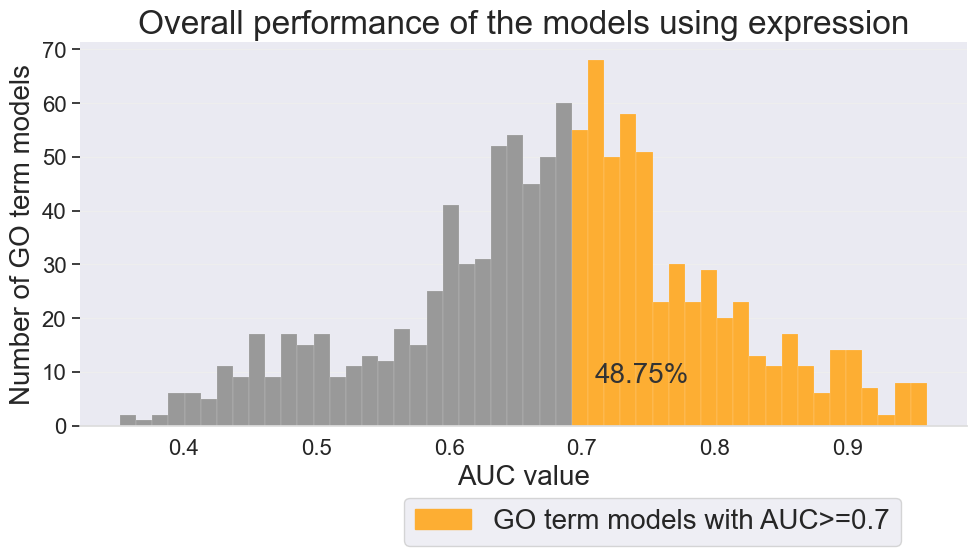

In [53]:
sns.set(rc={'figure.figsize':(10,6)})
fig, ax = plt.subplots()
perc = str(round((100*len(GO_terms_auc_svm_df[GO_terms_auc_svm_df["auc"]>0.69])/len(GO_terms_auc_svm_df)),2))+"%"
N, bins, patches = plt.hist(GO_terms_auc_svm_df, color=CB_color_cycle[6],bins=50, linewidth=0.1)

for i in range(0,len(bins)-1):
    if bins[i]>0.69:
        patches[i].set_facecolor(CB_color_cycle[2])

plt.yticks(fontsize=16)
plt.xticks(fontsize=16)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=True)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

plt.xlabel("AUC value", fontsize=20)
plt.ylabel("Number of GO term models", fontsize=20)
colors2 = {'GO term models with AUC>=0.7':CB_color_cycle[2]}  
labels = list(colors2.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors2[label]) for label in labels]
plt.legend(handles, labels,fontsize=20, loc="lower left", bbox_to_anchor=(0.35,-0.35))
plt.text(0.71, 8, str(perc), fontsize=20,color='#333333')
plt.title("Overall performance of the models using expression", fontsize=24)
# con el que mejor funciona es con la suma normal del attribution 
fig.tight_layout()
fig.savefig(resultsdir+'modelsAUCsvm.png', transparent=True)

## AUC waterfall plot

In [54]:
GO_terms_auc_svm_df =GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False)

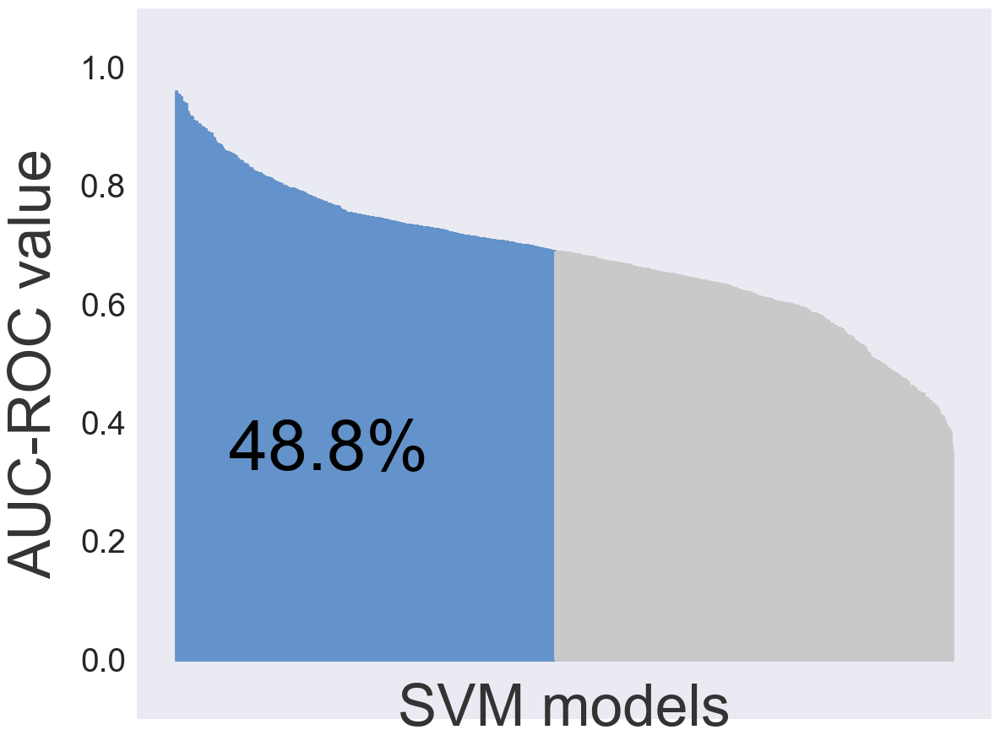

In [55]:
plt.rcParams['figure.figsize'] = (12, 9)
drugs = GO_terms_auc_svm_df.index
rhos = GO_terms_auc_svm_df["auc"]

percentage = round((sum(rhos>0.69)/len(rhos))*100,1)

fig, ax = plt.subplots()
#colors = ['#208EA3' if (x < 0.5) else '#A4C61A' for x in rhos ]
colors = ['#C9C9C9' if (x < 0.69) else "#6492CA" for x in rhos ]
ax.bar(
    x=drugs,
    height=rhos,
    edgecolor=colors,
    linewidth=2
)
plt.xticks([])
plt.yticks(fontsize=28)


# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
#ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=False)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(False)
ax.yaxis.grid(False)
#ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)


# Add labels and a title. Note the use of `labelpad` and `pad` to add some
# extra space between the text and the tick labels.
ax.set_xlabel('SVM models', labelpad=-30, color='#333333',fontsize=50)
ax.set_ylabel('AUC-ROC value', labelpad=15, color='#333333',fontsize=50)
ax.set_title('', color='#333333',
             weight='bold')

colors2 = {'High confidence drugs (r>0.5)':'#A4C61A'}  
labels = list(colors2.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors2[label]) for label in labels]
#plt.legend(handles, labels,fontsize=40, loc="lower left",bbox_to_anchor=(0, -0.215))
plt.text(77, 0.32, str(percentage)+"%", fontsize=60,color='#000000')

plt.ylim((-0.1,1.1))
# Make the chart fill out the figure better.
fig.tight_layout()
fig.savefig(resultsdir+'WaterfallModelsSVM.png', transparent=True)

## AUC boxplot by parents

In [56]:
# Add number of parents
number_parents = {}
levels = {}
for i in range(0,len(GO_terms_auc_svm_df.index)):
    term = GO_terms_auc_svm_df.index[i]
    number_parents[GO_terms_auc_svm_df.index[i]]=len([source for source, _ in  dG.in_edges(term)])
    levels[GO_terms_auc_svm_df.index[i]]=level_number[term]-1
levels = pd.DataFrame.from_dict(levels, orient='index')
number_parents = pd.DataFrame.from_dict(number_parents, orient='index')

GO_terms_auc_svm_df = pd.concat([GO_terms_auc_svm_df, levels,number_parents], axis=1)
GO_terms_auc_svm_df.columns = ["auc","levels","parents"]

In [57]:
GO_terms_auc_svm_df = GO_terms_auc_svm_df.sort_values(by=["levels"], ascending=True)

In [58]:
GO_terms_auc_svm_df.head()

,auc,levels,parents
GO:1901029,0.959991,0,10
GO:0070374,0.793109,0,3
GO:0043552,0.792174,0,3
GO:0003157,0.790148,0,2
GO:0090314,0.790000,0,7


In [73]:
c = ['#E8384F', '#FD817D', '#FDAE33','#EECC16', '#A4C61A', '#37A862',"#208EA3","#3B6EAB"]

df = px.data.tips()
fig = px.box(GO_terms_auc_svm_df, x="levels", y="auc",
             color="levels",
            color_discrete_sequence=c,
             width =600,
             height=400,
              template="simple_white",
              labels=dict(levels="Level of GO hierarchy", auc="AUROC")
            )
fig.update_traces(width=0.9)

fig.add_shape( # add a horizontal "target" line
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=0.7, y1=0.7, yref="y"
)


fig.update_layout(
   title=dict(text="<b> AUC value grouped by level of GO hierarchy <b>",
             x=0.5,
             y=0.9,
              font=dict(size=20),
              xanchor='center',
              yanchor='top'),
    xaxis=dict(ticks="", showticklabels=False, showgrid=False, zeroline=False),
    yaxis=dict(ticks="", showticklabels=True, showgrid=True, zeroline=False),
 #   yaxis_range=[min(yy.flatten()),max(yy.flatten())],
  #  xaxis_range=[min(xx.flatten()),max(xx.flatten())],
    legend=dict(x=1.1, y=1, orientation="v",font=dict(size=16)),
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    font=dict(family='Roboto',color= "#36382E",size=20)
    )

fig.show()
# pio.write_image(fig, resultsdir+"AUC_levels.png", width=600, height=400,scale=8)

## TOP 15 PREDICTED GO TERMS

In [74]:
top15goterms= np.array(GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False)[0:15].index)

Get Top GO term names

In [ ]:
top15goterms_1 = []
for goterm in top15goterms:
    top15goterms_1.append(goterm+"_"+str(1))
real_go_info_mod_best = real_go_info[real_go_info.GO_term.isin(top15goterms_1)]
real_go_info_mod_best.GO_term = real_go_info_mod_best.GO_term.str.replace("_1","")

In [76]:
top15goterms_auc = GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False)[0:15].reset_index()
top15goterms_auc.columns=["GO_term","auc","levels","parents"]

In [77]:
top15goterms_auc = top15goterms_auc.merge(real_go_info_mod_best[real_go_info_mod_best["GO_term"].isin(top15goterms)], on="GO_term")

In [78]:
top15goterms_auc

,GO_term,auc,levels,parents,Name,layer_number
0,GO:1901029,0.959991,0,10,Negative regulation of mitochondrial outer membrane permeabilization involved in apoptotic signaling pathway (1),0.0
1,GO:0044342,0.956590,1,1,Type b pancreatic cell proliferation (1),1.0
2,GO:0002326,0.955918,0,2,B cell lineage commitment (1),0.0
3,GO:0007006,0.955500,3,2,Mitochondrial membrane organization (1),3.0
4,GO:1902236,0.954857,0,6,Negative regulation of endoplasmic reticulum stress-induced intrinsic apoptotic signaling pathway (1),0.0
5,GO:1900118,0.953573,0,3,Negative regulation of execution phase of apoptosis (1),0.0
6,GO:0030279,0.950408,1,3,Negative regulation of ossification (1),1.0
7,GO:0051452,0.949592,1,1,Intracellular ph reduction (1),1.0
8,GO:0033033,0.944694,0,3,Negative regulation of myeloid cell apoptotic process (1),0.0
9,GO:0060020,0.944502,0,1,Bergmann glial cell differentiation (1),0.0


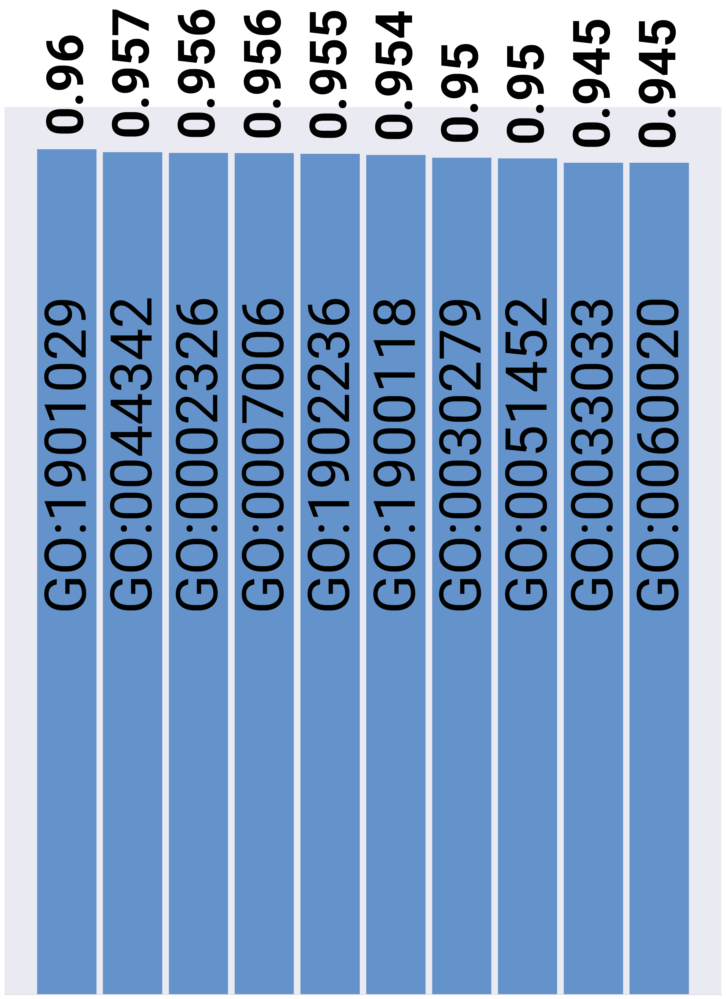

In [79]:
plt.rcParams['figure.figsize'] = (16, 22)
fig, ax = plt.subplots()
rhos_top=top15goterms_auc["auc"][0:10]
drugs_top=top15goterms_auc["GO_term"][0:10]

colors = [CB_color_cycle[2] if (x < 0.5) else "#6492CA" for x in rhos_top ]
bars = ax.bar(
    x=drugs_top,
    height=rhos_top,
    edgecolor="none",
    linewidth=1,
    color = colors,
    width=0.9
)
#plt.yticks(fontsize=30)
plt.yticks([])
plt.xticks([])

# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')



# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
#ax.yaxis.grid(False, color='#EEEEEE')
ax.xaxis.grid(False)

#plt.xticks(rotation=80,fontsize=40)

# Add text annotations to the top of the bars.
bar_color = bars[0].get_facecolor()
for bar in bars:
  ax.text(
      
      bar.get_x() + bar.get_width() / 2,
      bar.get_height() + 0.03,
      round(bar.get_height(), 3),
      horizontalalignment='center',
      #color=bar_color,
      color='#000000',
      weight='bold',
      fontsize=80,
      rotation="vertical"
  )

i=0
for bar in bars:
    ax.text(
      
      bar.get_x() + bar.get_width() / 2,
      0.45,
      drugs_top[i],
      horizontalalignment='center',
      #color=bar_color,
      color='#000000',
      #weight='bold',
      fontsize=90,
      rotation="vertical"
    )
    i=i+1

ax.tick_params(bottom=True, left=False, axis='x', which='major', pad=-1)
# Add labels and a title. Note the use of `labelpad` and `pad` to add some
# extra space between the text and the tick labels.
ax.set_xlabel('', labelpad=15, color='#333333')
#ax.set_ylabel('r', labelpad=15, color='#333333',fontsize=30)
ax.set_title('', color='#333333',
             weight='bold')

# Make the chart fill out the figure better.
fig.tight_layout()

fig.savefig(resultsdir+'top10svm_models.png', transparent=True)

## WORST 15 PREDICTED GO TERMS

In [80]:
worst15goterms= np.array(GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=True)[0:15].index)

Get Worst GO term names

In [ ]:
worst15goterms_1 = []
for goterm in worst15goterms:
    worst15goterms_1.append(goterm+"_"+str(1))
real_go_info_mod_worst = real_go_info[real_go_info.GO_term.isin(worst15goterms_1)]
real_go_info_mod_worst.GO_term = real_go_info_mod_worst.GO_term.str.replace("_1","")

In [85]:
worst15goterms_auc = GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=True)[0:15].reset_index()
worst15goterms_auc.columns=["GO_term","auc","levels","parents"]

In [86]:
worst15goterms_auc.merge(real_go_info_mod_worst[real_go_info_mod_worst["GO_term"].isin(worst15goterms)], on="GO_term")

,GO_term,auc,levels,parents,Name,layer_number
0,GO:0032412,0.351992,3,3,Regulation of ion transmembrane transporter activity (1),3.0
1,GO:0017157,0.363878,3,5,Regulation of exocytosis (1),3.0
2,GO:0014013,0.372925,1,2,Regulation of gliogenesis (1),1.0
3,GO:0071356,0.384013,3,2,Cellular response to tumor necrosis factor (1),3.0
4,GO:0006163,0.385537,4,2,Purine nucleotide metabolic process (1),4.0
5,GO:0048660,0.389564,2,2,Regulation of smooth muscle cell proliferation (1),2.0
6,GO:2000146,0.390756,5,3,Negative regulation of cell motility (1),5.0
7,GO:0019827,0.393045,2,1,Stem cell population maintenance (1),2.0
8,GO:0006475,0.395102,3,1,Internal protein amino acid acetylation (1),3.0
9,GO:0015833,0.395593,5,2,Peptide transport (1),5.0


## AUPR histogram

In [87]:
GO_terms_aupr_svm_df = pd.DataFrame(list(GO_terms_aupr_svm.items()),columns = ['goterm','aupr']).set_index("goterm")
GO_terms_aupr_svm_df = GO_terms_aupr_svm_df.dropna()
GO_terms_aupr_svm_df.sort_values(by=["aupr"], ascending=False).head()

,aupr
goterm,
GO:0006468,0.913629
GO:0001782,0.908636
GO:0036211,0.886811
GO:0009058,0.886773
GO:0033033,0.881536


In [88]:
# Add number of parents
number_parents = {}
levels = {}
for i in range(0,len(GO_terms_aupr_svm_df.index)):
    term = GO_terms_aupr_svm_df.index[i]
    number_parents[GO_terms_aupr_svm_df.index[i]]=len([source for source, _ in  dG.in_edges(term)])
    levels[GO_terms_aupr_svm_df.index[i]]=level_number[term]-1
levels = pd.DataFrame.from_dict(levels, orient='index')
number_parents = pd.DataFrame.from_dict(number_parents, orient='index')

GO_terms_aupr_svm_df = pd.concat([GO_terms_aupr_svm_df, levels,number_parents], axis=1)
GO_terms_aupr_svm_df.columns = ["aupr","levels","parents"]

In [89]:
GO_terms_aupr_svm_df = GO_terms_aupr_svm_df.sort_values(by=["levels"], ascending=True)

In [91]:

c = ['#E8384F', '#FD817D', '#FDAE33','#EECC16', '#A4C61A', '#37A862',"#208EA3","#3B6EAB"]

df = px.data.tips()
fig = px.box(GO_terms_aupr_svm_df, x="levels", y="aupr",
             color="levels",
            color_discrete_sequence=c,
             width =600,
             height=400,
              template="simple_white",
              labels=dict(levels="Level of GO hierarchy", aupr="AUPR")
            )
fig.update_traces(width=0.9)

fig.add_shape( # add a horizontal "target" line
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=0.7, y1=0.7, yref="y"
)


fig.update_layout(
   title=dict(text="<b> AUPR value grouped by level of GO hierarchy <b>",
             x=0.5,
             y=0.9,
              font=dict(size=20),
              xanchor='center',
              yanchor='top'),
    xaxis=dict(ticks="", showticklabels=False, showgrid=False, zeroline=False),
    yaxis=dict(ticks="", showticklabels=True, showgrid=True, zeroline=False),
 #   yaxis_range=[min(yy.flatten()),max(yy.flatten())],
  #  xaxis_range=[min(xx.flatten()),max(xx.flatten())],
    legend=dict(x=1.1, y=1, orientation="v",font=dict(size=16)),
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    font=dict(family='Roboto',color= "#36382E",size=20)
    )

fig.show()
# pio.write_image(fig, resultsdir+"AUPR_levels.png", width=600, height=400,scale=8)

## Example prediction

In [92]:
def f2(goterm):    
    return goterm

In [93]:
combobox_go = interactive(f2, goterm=widgets.Combobox(options=list(GO_terms_auc_svm_df.sort_values(by=["auc"], ascending=False).index)))

**Choose drug to study...**

In [94]:
display(combobox_go)

interactive(children=(Combobox(value='', description='goterm', options=('GO:1901029', 'GO:0044342', 'GO:000232…

In [95]:
selected_go = combobox_go.result

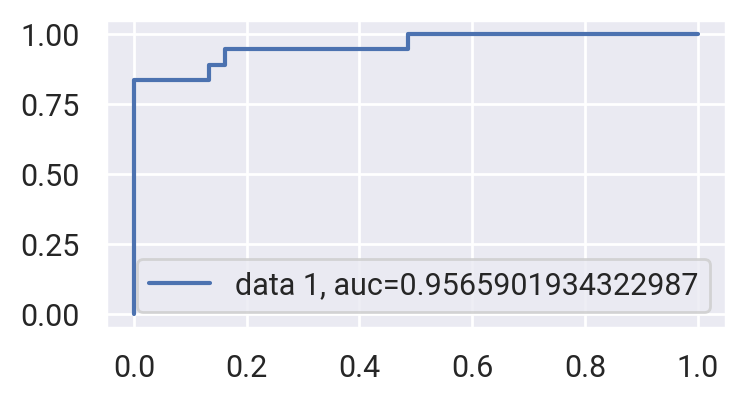

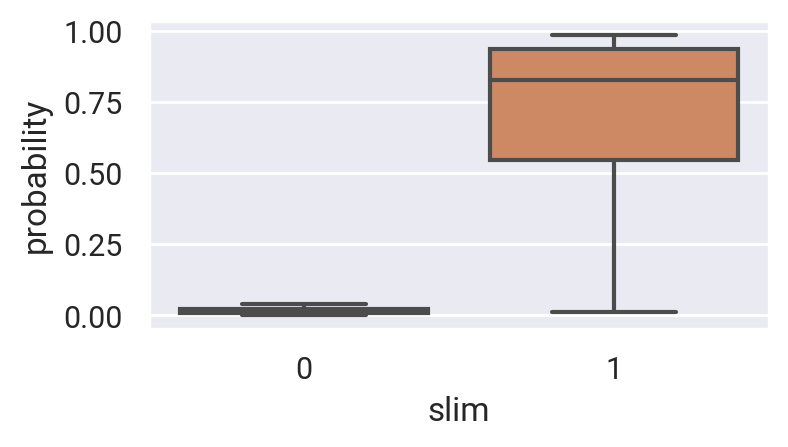

In [96]:
#auc
plt.rcParams['figure.figsize'] = (4, 2)
fpr, tpr, _ = metrics.roc_curve(slim_matrix_single_neuron.loc[selected_go],  platt_matrix.loc[selected_go])
auc = metrics.roc_auc_score(slim_matrix_single_neuron.loc[selected_go],  platt_matrix.loc[selected_go])
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

plot = pd.concat([pd.DataFrame(slim_matrix_single_neuron.loc[selected_go]),pd.DataFrame(platt_matrix.loc[selected_go])], axis=1)
plot.columns = ["slim","probability"]
ax = sns.boxplot(x="slim", y="probability", data=plot,showfliers=False )

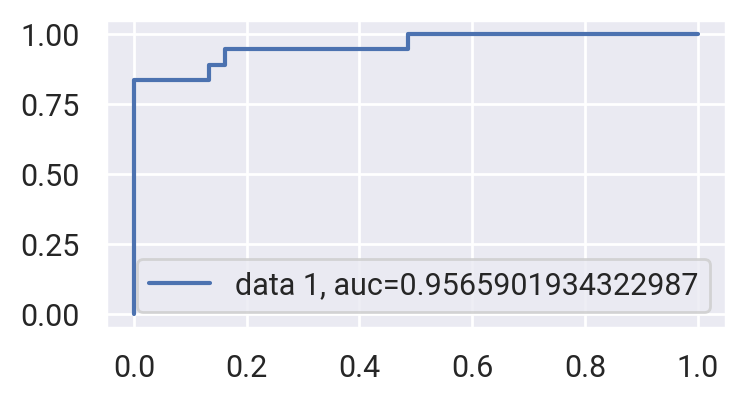

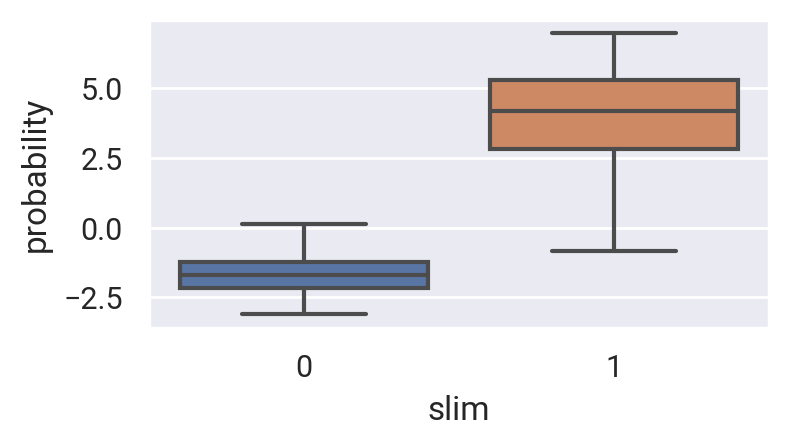

In [97]:
#auc 
fpr, tpr, _ = metrics.roc_curve(slim_matrix_single_neuron.loc[selected_go],  delta_logits_matrix.loc[selected_go])
auc = metrics.roc_auc_score(slim_matrix_single_neuron.loc[selected_go],  delta_logits_matrix.loc[selected_go])
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

plot = pd.concat([pd.DataFrame(slim_matrix_single_neuron.loc[selected_go]),pd.DataFrame(delta_logits_matrix.loc[selected_go])], axis=1)
plot.columns = ["slim","probability"]
ax = sns.boxplot(x="slim", y="probability", data=plot,showfliers=False )

Accuracy: 0.9735849056603774
Precision: 0.7894736842105263
Recall: 0.8333333333333334
AUC with score: 0.9565901934322987


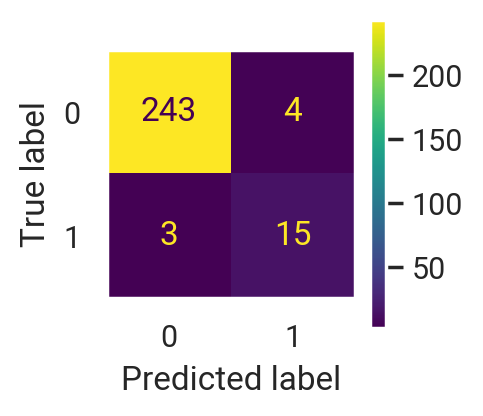

In [98]:
plt.rcParams['figure.figsize'] = (2, 2)
metrics.ConfusionMatrixDisplay.from_predictions(slim_matrix_single_neuron.loc[selected_go], preds_svm_matrix.loc[selected_go])
plt.grid(visible=None)

print("Accuracy:",metrics.accuracy_score(slim_matrix_single_neuron.loc[selected_go], preds_svm_matrix.loc[selected_go]))
print("Precision:",metrics.precision_score(slim_matrix_single_neuron.loc[selected_go], preds_svm_matrix.loc[selected_go]))
print("Recall:",metrics.recall_score(slim_matrix_single_neuron.loc[selected_go], preds_svm_matrix.loc[selected_go])) #TP / (TP+FN)
print("AUC with score:",auc) #TP / (TP+FN)

TN  -  FP

FN  -  TP

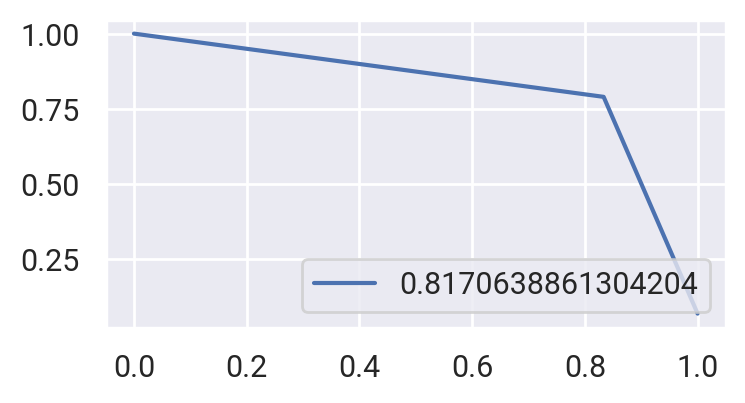

In [99]:
plt.rcParams['figure.figsize'] = (4, 2)
precision, recall, thresholds = metrics.precision_recall_curve(slim_matrix_single_neuron.loc[selected_go],  preds_svm_matrix.loc[selected_go])
auc_precision_recall = metrics.auc(recall, precision)
plt.plot(recall, precision,label=str(auc_precision_recall))
plt.legend(loc=4)
plt.show()

## METRICS drugs

In [100]:
auc_drugs = {}
aupr_drugs = {}
precision_drugs = {}
for drug in list(slim_matrix_single_neuron.columns):
    if slim_matrix_single_neuron.loc[:,drug].sum() ==0:
        continue
    #fpr, tpr, _ = metrics.roc_curve(slim_matrix_single_neuron.loc[:,drug], logits_matrix.loc[:,drug])
    #auc_drugs[drug]  = metrics.auc(fpr, tpr)
    auc_drugs[drug] = metrics.roc_auc_score(slim_matrix_single_neuron.loc[:,drug],  platt_matrix.loc[:,drug])
    precision, recall, thresholds = metrics.precision_recall_curve(slim_matrix_single_neuron.loc[:,drug],  platt_matrix.loc[:,drug])
    aupr_drugs[drug] = metrics.auc(recall, precision)
    precision_drugs[drug] = metrics.precision_score(slim_matrix_single_neuron.loc[:,drug],  preds_svm_matrix.loc[:,drug])

auc_drugs_df = pd.DataFrame(list(auc_drugs.items()),columns = ['goterm','auc']).set_index("goterm")
auc_drugs_df = auc_drugs_df.dropna()

aupr_drugs_df = pd.DataFrame(list(aupr_drugs.items()),columns = ['goterm','aupr']).set_index("goterm")
aupr_drugs_df = aupr_drugs_df.dropna()

precision_drugs_df = pd.DataFrame(list(precision_drugs.items()),columns = ['goterm','precision']).set_index("goterm")
precision_drugs_df = precision_drugs_df.dropna()

### AUC histogram drugs

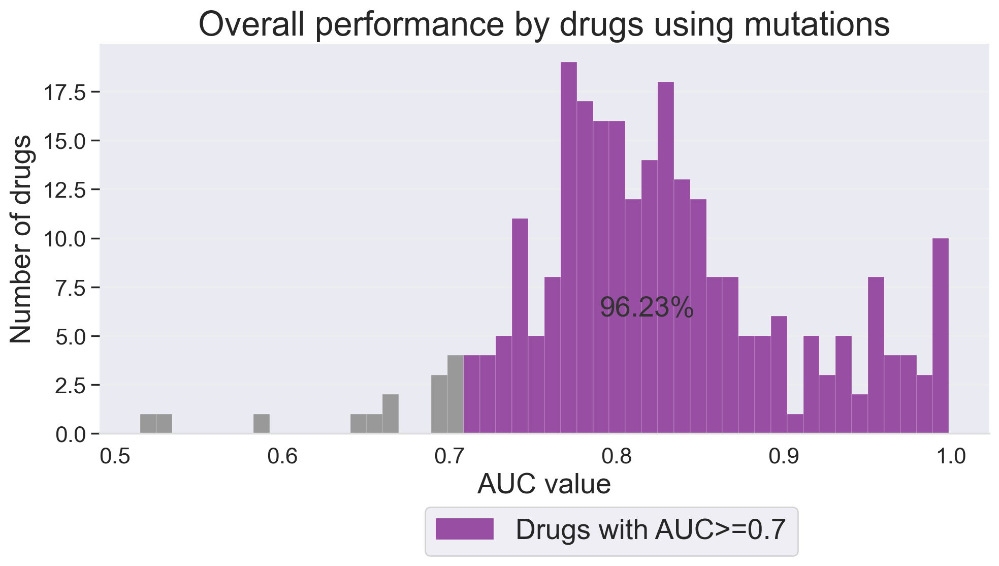

In [101]:
sns.set(rc={'figure.figsize':(10,6)})
fig, ax = plt.subplots()
perc = str(round((100*len(auc_drugs_df[auc_drugs_df["auc"]>0.7])/len(auc_drugs_df)),2))+"%"
N, bins, patches = plt.hist(auc_drugs_df, color=CB_color_cycle[6],bins=50, linewidth=0.1)

for i in range(0,len(bins)-1):
    if bins[i]>0.7:
        patches[i].set_facecolor(CB_color_cycle[5])

plt.yticks(fontsize=16)
plt.xticks(fontsize=16)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=True)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

plt.xlabel("AUC value", fontsize=20)
plt.ylabel("Number of drugs", fontsize=20)
colors2 = {'Drugs with AUC>=0.7':CB_color_cycle[5]}  
labels = list(colors2.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors2[label]) for label in labels]
plt.legend(handles, labels,fontsize=20, loc="lower left", bbox_to_anchor=(0.35,-0.35))
plt.text(0.79, 6, str(perc), fontsize=20,color='#333333')
plt.title("Overall performance by drugs using mutations", fontsize=24)
# con el que mejor funciona es con la suma normal del attribution 
fig.tight_layout()
fig.savefig(resultsdir+'drugsAUC.png', transparent=True)

### AUC waterfall plot drugs

In [102]:
auc_drugs_df =auc_drugs_df.sort_values(by=["auc"], ascending=False)

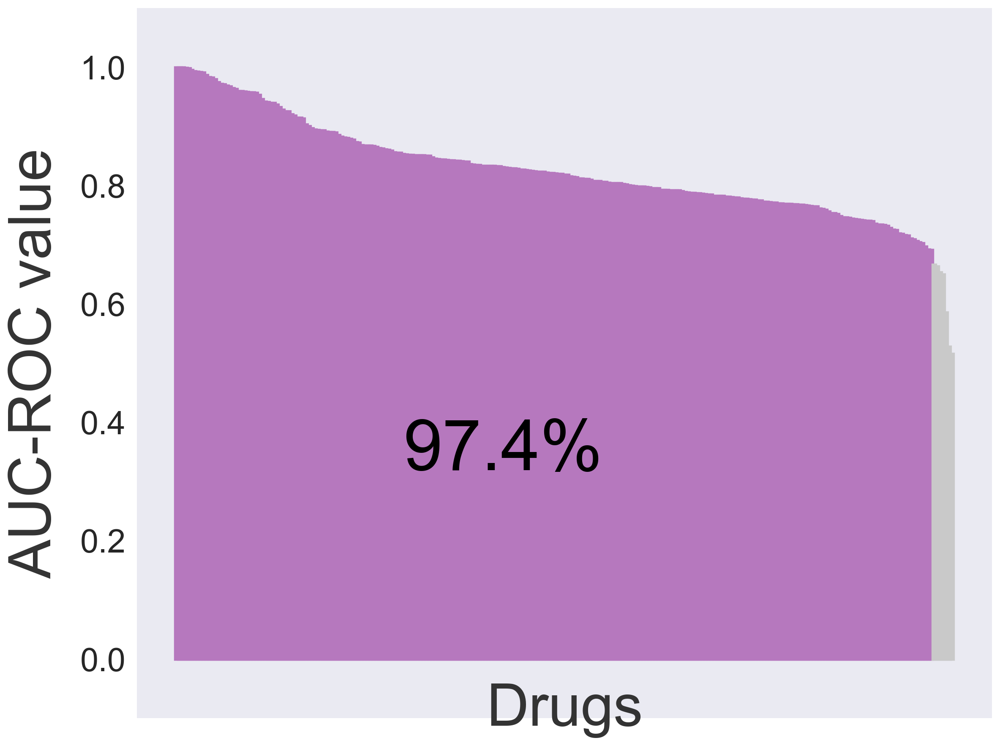

In [103]:
plt.rcParams['figure.figsize'] = (12, 9)
drugs = auc_drugs_df.index
rhos = auc_drugs_df["auc"]

percentage = round((sum(rhos>0.69)/len(rhos))*100,1)

fig, ax = plt.subplots()
#colors = ['#208EA3' if (x < 0.5) else '#A4C61A' for x in rhos ]
colors = ['#C9C9C9' if (x < 0.69) else "#B678BE" for x in rhos ]
ax.bar(
    x=drugs,
    height=rhos,
    edgecolor=colors,
    linewidth=3
)
plt.xticks([])
plt.yticks(fontsize=28)


# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
#ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=False)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(False)
ax.yaxis.grid(False)
#ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)


# Add labels and a title. Note the use of `labelpad` and `pad` to add some
# extra space between the text and the tick labels.
ax.set_xlabel('Drugs', labelpad=-30, color='#333333',fontsize=50)
ax.set_ylabel('AUC-ROC value', labelpad=15, color='#333333',fontsize=50)
ax.set_title('', color='#333333',
             weight='bold')

colors2 = {'High confidence drugs (r>0.5)':'#A4C61A'}  
labels = list(colors2.keys())
handles = [plt.Rectangle((0,0),1,1, color=colors2[label]) for label in labels]
#plt.legend(handles, labels,fontsize=40, loc="lower left",bbox_to_anchor=(0, -0.215))
plt.text(77, 0.32, str(percentage)+"%", fontsize=60,color='#000000')

plt.ylim((-0.1,1.1))
# Make the chart fill out the figure better.
fig.tight_layout()
fig.savefig(resultsdir+'WaterfallModelsSVM_drugs.png', transparent=True)

### AUPR histogram drugs

Text(0.5, 1.0, '33.58%')

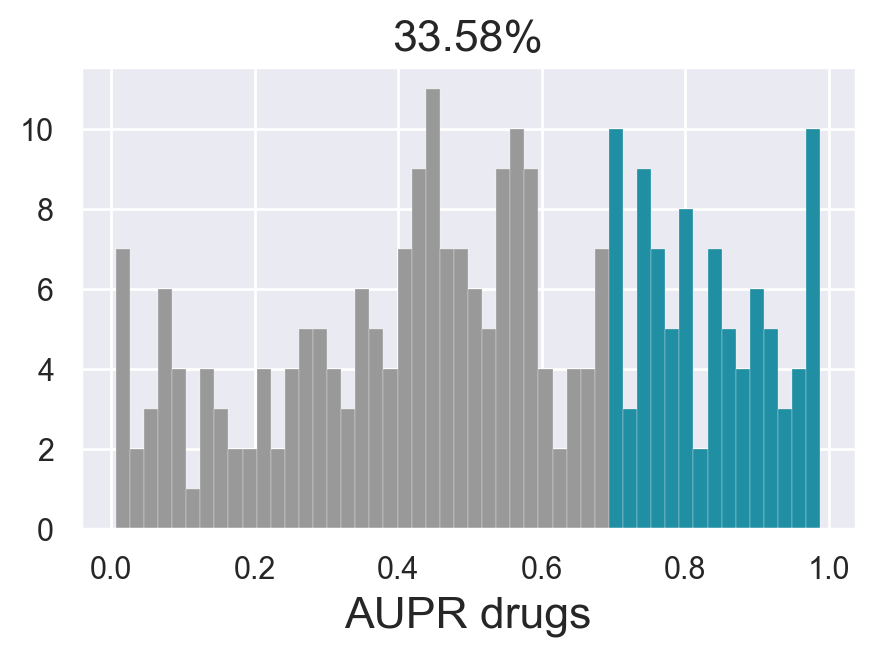

In [104]:
sns.set(rc={'figure.figsize':(5,3)})
perc = str(round((100*len(aupr_drugs_df[aupr_drugs_df["aupr"]>0.69])/len(aupr_drugs_df)),2))+"%"
N, bins, patches = plt.hist(aupr_drugs_df, color=CB_color_cycle[6],bins=50, linewidth=0.1)
for i in range(0,len(bins)-1):
    if bins[i]>0.69:
        patches[i].set_facecolor(CB_color_cycle[3])

plt.xlabel("AUPR drugs", fontsize=16)  
plt.title(perc, fontsize=16)

### Example drug prediction

In [105]:
def f(drug):    
    
    return drug

In [106]:
predictions_nodes = []
for goterm in list(platt_matrix.index):
    predictions_nodes.append(goterm+"_"+str(1))

In [ ]:
# add names to go terms
real_go_info_svm= real_go_info[real_go_info.GO_term.isin(predictions_nodes)]
real_go_info_svm.GO_term = real_go_info_svm.GO_term.str.replace("_1","")

In [108]:
combobox = interactive(f, drug=widgets.Combobox(options=list(precision_drugs_df.sort_values(by=["precision"], ascending=False).index)))

**Choose drug to study...**

In [198]:
display(combobox)

interactive(children=(Combobox(value='Afatinib', description='drug', options=('(5Z)-7-Oxozeaenol', '5-Fluorour…

In [202]:
selected_drug_name = combobox.result

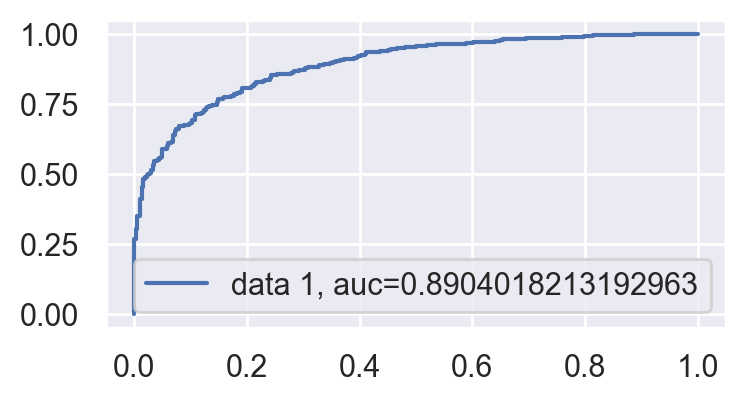

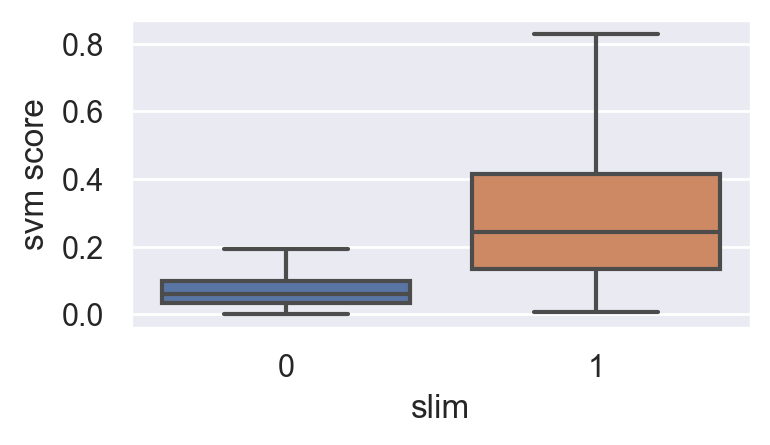

In [206]:
sns.set(rc={'figure.figsize':(4,2)})
#auc
fpr, tpr, _ = metrics.roc_curve(slim_matrix_single_neuron.loc[:,selected_drug_name], platt_matrix.loc[:,selected_drug_name] )
auc = metrics.roc_auc_score(slim_matrix_single_neuron.loc[:,selected_drug_name],  platt_matrix.loc[:,selected_drug_name])
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

plot = pd.concat([pd.DataFrame(slim_matrix_single_neuron.loc[:,selected_drug_name]),pd.DataFrame(platt_matrix.loc[:,selected_drug_name])], axis=1)
plot.columns = ["slim","svm score"]
ax = sns.boxplot(x="slim", y="svm score", data=plot,showfliers=False )

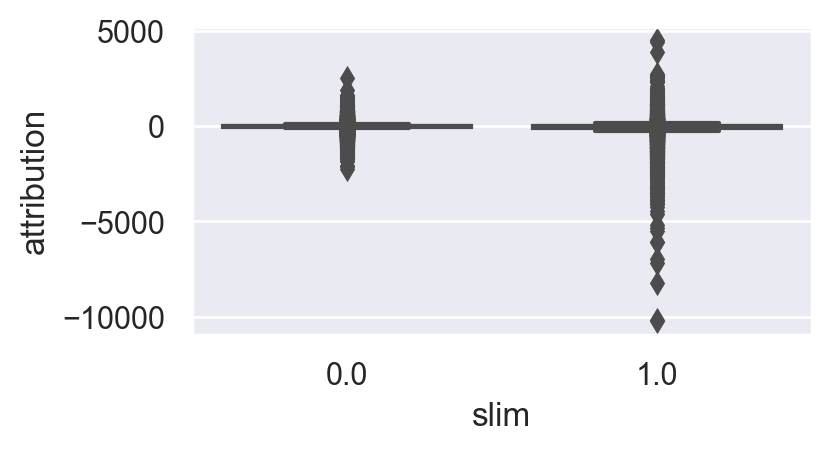

In [207]:
plot = pd.concat([pd.DataFrame(slim_matrix.loc[:,selected_drug_name]),pd.DataFrame(attribution_data_annotated.loc[:,selected_drug_name]*1e4)], axis=1)
plot.columns = ["slim","attribution"]
ax = sns.boxplot(x="slim", y="attribution", data=plot,showfliers=True )

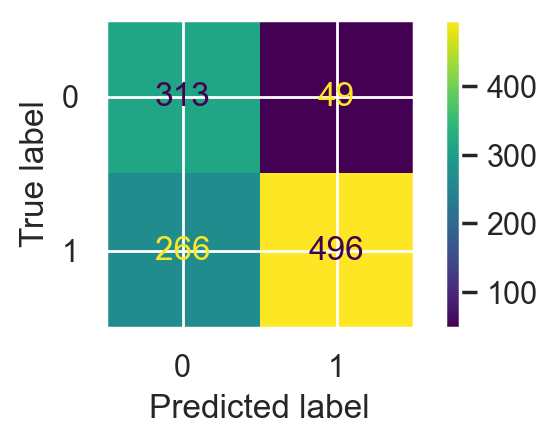

In [208]:
metrics.ConfusionMatrixDisplay.from_predictions(slim_matrix_single_neuron.loc[:,selected_drug_name].round(), preds_svm_matrix.loc[:,selected_drug_name])

In [209]:
print("Accuracy:",metrics.accuracy_score(slim_matrix_single_neuron.loc[:,selected_drug_name], preds_svm_matrix.loc[:,selected_drug_name]))
print("Precision:",metrics.precision_score(slim_matrix_single_neuron.loc[:,selected_drug_name], preds_svm_matrix.loc[:,selected_drug_name]))
print("Recall:",metrics.recall_score(slim_matrix_single_neuron.loc[:,selected_drug_name], preds_svm_matrix.loc[:,selected_drug_name])) #TP / (TP+FN)
print("AUC with score:",auc) 

Accuracy: 0.7197508896797153
Precision: 0.9100917431192661
Recall: 0.6509186351706037
AUC with score: 0.8904018213192963


In [210]:
# LOS LOGITS DE TEST!!
train_drug_logs = pd.DataFrame(delta_logits_matrix.loc[:,selected_drug_name]).reset_index()
train_drug_logs.columns  = ["GO_term","probability"]
train_drug_logs = train_drug_logs.merge(real_go_info_svm, on="GO_term")
train_drug_logs.sort_values(by=["probability"], ascending=False).head(10)

,GO_term,probability,Name,layer_number
329,GO:0006939,2.871769,Smooth muscle contraction (1),3.0
381,GO:0048041,2.568268,Focal adhesion assembly (1),2.0
144,GO:0002318,2.533049,Myeloid progenitor cell differentiation (1),0.0
408,GO:0048008,2.529048,Platelet-derived growth factor receptor signaling pathway (1),1.0
595,GO:0032526,2.437785,Response to retinoic acid (1),1.0
822,GO:0046651,2.300822,Lymphocyte proliferation (1),4.0
183,GO:0048608,2.222701,Reproductive structure development (1),3.0
458,GO:0048839,2.066365,Inner ear development (1),3.0
793,GO:1901888,2.058388,Regulation of cell junction assembly (1),2.0
956,GO:0002327,1.921062,Immature b cell differentiation (1),0.0


## Final model SVM

Once the models have been cross-validated we create the final models using all samples...

In [116]:
GO_terms_auc_svm_final = {}
GO_terms_aupr_svm_final = {}
GO_terms_precision_svm_final = {}
models_svm = {}

# Perform logistics
for goterm in sparseGO_terms:
    #print(goterm)
    goterm_drugs = slim_matrix.loc[[goterm+"_"+str(1)]].values.flatten()
    
    if sum(goterm_drugs) <= 16:
        continue

    list_nodes = []
    for i in range(1,7):
        list_nodes.append(goterm+"_"+str(i))

    score = attribution_data_annotated.loc[list_nodes].T
    score_mod = score.divide(score.std()).fillna(0)
    
    X_train = score_mod
    X_test = score_mod
    y_train = goterm_drugs
    y_test = goterm_drugs
    
    #gamma = 1/(X_train.shape[1]*X_train.to_numpy().var())
    gamma="scale"
    C=1
    
    
        
    svm_model = svm.SVC(C=C,gamma=gamma, kernel='rbf',
                           class_weight="balanced",
                            tol=0.001,
                            probability=True,
                           random_state=1234)
    # fit the model with data
    svm_model.fit(X_train,y_train)
    y_pred=svm_model.predict(X_test)

    #auc
    y_pred_proba = svm_model.predict_proba(X_test)[::,1]  # platt values
    #y_pred_proba = svm_model.decision_function(X_test)
    
    GO_terms_auc_svm_final[goterm] = metrics.roc_auc_score(y_test, y_pred_proba)

    precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_pred_proba)
    GO_terms_aupr_svm_final[goterm] = metrics.auc(recall, precision)
    GO_terms_precision_svm_final[goterm] = metrics.precision_score(y_test, y_pred)
    models_svm[goterm]=svm_model

In [117]:
len(models_svm)

1124

### Final model AUC

In [118]:
GO_terms_auc_svm_df_final = pd.DataFrame(list(GO_terms_auc_svm_final.items()),columns = ['goterm','auc']).set_index("goterm")
GO_terms_auc_svm_df_final = GO_terms_auc_svm_df_final.dropna()
GO_terms_auc_svm_df_final.sort_values(by=["auc"], ascending=False).head()

,auc
goterm,
GO:0030890,0.995511
GO:1901029,0.994437
GO:0051452,0.993673
GO:0030279,0.993469
GO:1901863,0.991582


Text(0.5, 1.0, '93.42%')

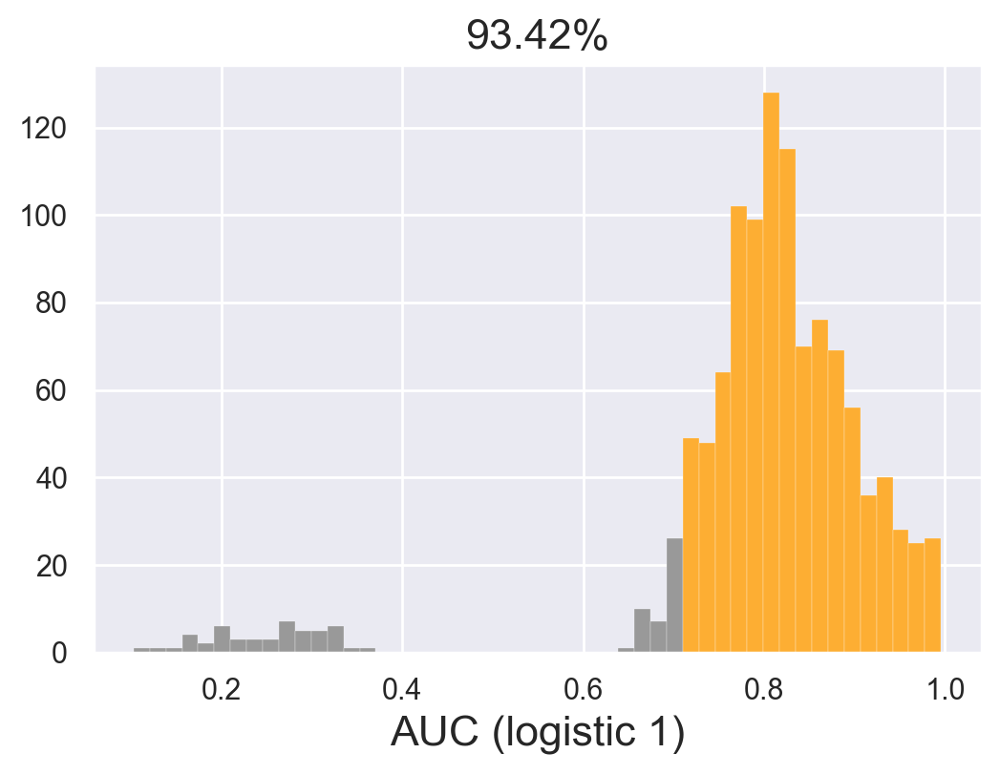

In [119]:
sns.set(rc={'figure.figsize':(6,4)})
perc = str(round((100*len(GO_terms_auc_svm_df_final[GO_terms_auc_svm_df_final["auc"]>0.7])/len(GO_terms_auc_svm_df_final)),2))+"%"
N, bins, patches = plt.hist(GO_terms_auc_svm_df_final, color=CB_color_cycle[6],bins=50, linewidth=0.1)

for i in range(0,len(bins)-1):
    if bins[i]>0.7:
        patches[i].set_facecolor(CB_color_cycle[2])

plt.xlabel("AUC (logistic 1)", fontsize=16)  
plt.title(perc, fontsize=16)
# con el que mejor funciona es con la suma normal del attribution 

### Final model AUPR

In [120]:
GO_terms_aupr_svm_df_final = pd.DataFrame(list(GO_terms_aupr_svm_final.items()),columns = ['goterm','aupr']).set_index("goterm")
GO_terms_aupr_svm_df_final = GO_terms_aupr_svm_df_final.dropna()
GO_terms_aupr_svm_df_final.sort_values(by=["aupr"], ascending=False).head()

,aupr
goterm,
GO:0009058,0.974362
GO:0030890,0.965743
GO:0033033,0.965598
GO:0097345,0.960797
GO:0010467,0.959505


Text(0.5, 1.0, '23.31%')

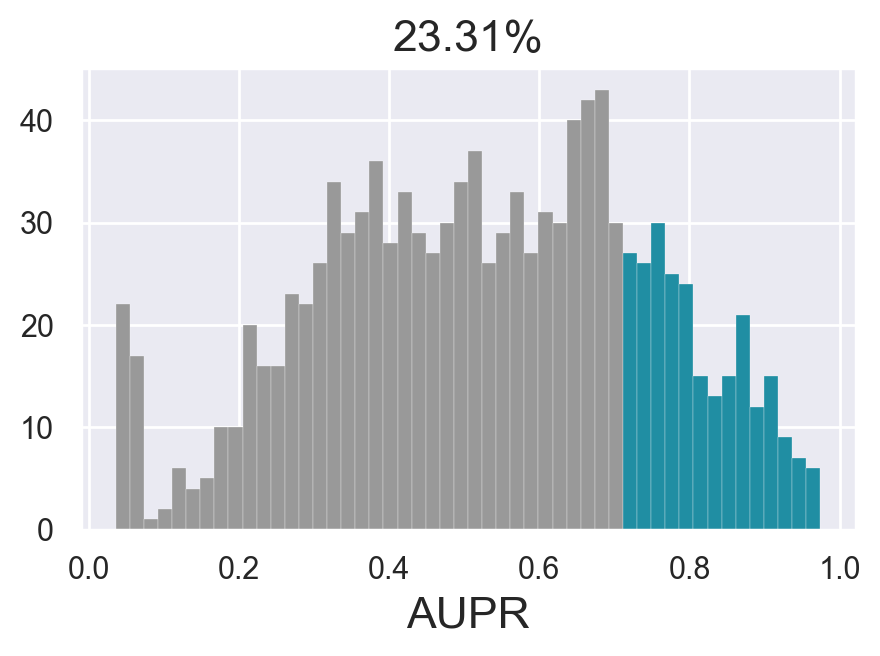

In [121]:
# TENGO PROBLEMA CON EL RECALL 
sns.set(rc={'figure.figsize':(5,3)})
perc = str(round((100*len(GO_terms_aupr_svm_df_final[GO_terms_aupr_svm_df_final["aupr"]>0.7])/len(GO_terms_aupr_svm_df_final)),2))+"%"
N, bins, patches = plt.hist(GO_terms_aupr_svm_df_final, color=CB_color_cycle[6],bins=50, linewidth=0.1)
for i in range(0,len(bins)-1):
    if bins[i]>0.7:
        patches[i].set_facecolor(CB_color_cycle[3])

plt.xlabel("AUPR", fontsize=16)  
plt.title(perc, fontsize=16)

## Predict for a new drug 

### Make predictions

In [122]:
unknown = list(set(attribution_data_all.columns)-set(attribution_data_annotated.columns))

Get the probabilities for all unknown drugs

In [ ]:
predictions = {}
distances = {}
probabilities_unknown = pd.DataFrame()
preds_unknown = pd.DataFrame()

for drug in unknown:
    probabilities = {}
    for goterm in models_svm.keys():

        list_nodes = list(models_svm[goterm].feature_names_in_) # Extract the feature names from the model (those are the attributions we need)

        score = attribution_data_all.loc[list_nodes][drug].to_frame().T 
        score_mod = score.divide(attribution_data_annotated.loc[list_nodes].T.std()).fillna(0) #divide by std of each neuron, only use drugs that trained the models

        predictions[goterm]=models_svm[goterm].predict(score_mod)
        probabilities[goterm] = models_svm[goterm].predict_proba(score_mod)[::,1]  # platt values
        # distances[goterm] = models_svm[goterm].decision_function(score_mod)
        
    drug_probs = pd.DataFrame.from_dict(probabilities).T
    drug_probs.columns = [drug]
    drug_preds = pd.DataFrame.from_dict(predictions).T
    drug_preds.columns = [drug]    
    probabilities_unknown = pd.concat([probabilities_unknown,drug_probs], axis=1)
    preds_unknown = pd.concat([preds_unknown,drug_preds], axis=1)
    print(drug)

In [123]:
# To import dataframe created before
with open(resultsdir+'probabilities_unknown_SVM.pkl', 'rb') as dictionary_file:
    probabilities_unknown = pickle.load(dictionary_file)  

with open(resultsdir+'preds_unknown_SVM.pkl', 'rb') as dictionary_file:
    preds_unknown = pickle.load(dictionary_file) 

### Study drug with unknown MOA

**Choose drug with unknown MOA...**

In [124]:
combobox_u = interactive(f, drug=widgets.Combobox(options=unknown))

In [125]:
predictions_nodes = []
for goterm in list(platt_matrix.index):
    predictions_nodes.append(goterm+"_"+str(1))

In [ ]:
# add names to go terms
real_go_info_svm= real_go_info[real_go_info.GO_term.isin(predictions_nodes)]
real_go_info_svm.GO_term = real_go_info_svm.GO_term.str.replace("_1","")

In [127]:
display(combobox_u)

interactive(children=(Combobox(value='', description='drug', options=('brd-k27188169', 'brd-k13999467', 'sch-5…

In [128]:
selected_drug_u_name = combobox_u.result

In [129]:
predictions_df = pd.DataFrame.from_dict(preds_unknown.loc[:,selected_drug_u_name]).reset_index()
predictions_df.columns  = ["GO_term","predictions"]

In [130]:
probabilities_df = pd.DataFrame.from_dict(probabilities_unknown.loc[:,selected_drug_u_name]).reset_index()
probabilities_df.columns  = ["GO_term","probability"]
probabilities_df = probabilities_df.merge(real_go_info_svm, on="GO_term")
probabilities_df = probabilities_df.merge(predictions_df, on="GO_term")
probabilities_df.loc[probabilities_df["layer_number"] <=3].sort_values(by=["probability"], ascending=False).head(30)

,GO_term,probability,Name,layer_number,predictions
15,GO:0007051,0.775651,Spindle organization (1),3.0,1.0
25,GO:0045930,0.728483,Negative regulation of mitotic cell cycle (1),3.0,1.0
312,GO:0033033,0.668570,Negative regulation of myeloid cell apoptotic process (1),0.0,1.0
85,GO:0001783,0.648156,B cell apoptotic process (1),1.0,1.0
241,GO:0018105,0.645704,Peptidyl-serine phosphorylation (1),2.0,1.0
579,GO:0031328,0.645487,Positive regulation of cellular biosynthetic process (1),3.0,1.0
365,GO:0007098,0.597286,Centrosome cycle (1),3.0,1.0
789,GO:1900118,0.562231,Negative regulation of execution phase of apoptosis (1),0.0,1.0
444,GO:1901990,0.539374,Regulation of mitotic cell cycle phase transition (1),3.0,1.0
636,GO:0042633,0.538572,Hair cycle (1),2.0,1.0


In [131]:
sum(probabilities_df["predictions"] ==1)

303

In [132]:
sum(probabilities_df["predictions"] ==0)

821

Probability < 0.5 doesn't mean it does not belong to the class, a probability of for example 0.2 can represent a 1 (annotated to MoA)

## Modify probabilities 

**Take into account the annotations each GO term has** (general GO terms are easier to predict as they have more annotations)

### For drug with unknown MOA...

In [133]:
sum_annotations = slim_matrix_single_neuron.T.sum()/slim_matrix_single_neuron.shape[1]
logits_apriori = np.log(sum_annotations/(1-sum_annotations))

logits_apost= np.log(probabilities_df["probability"]/(1-probabilities_df["probability"]))
delta_logits =logits_apost.to_numpy()- logits_apriori.to_numpy()
delta_logits_df = pd.DataFrame(delta_logits)
delta_logits_df.columns = ["delta_logits"]
probabilities_mod = probabilities_df.merge(delta_logits_df, left_index=True,right_index=True)

In [134]:
probabilities_mod.loc[probabilities_mod["predictions"] ==1].loc[probabilities_mod["layer_number"] <= 7].sort_values(by=["delta_logits"], ascending=False).head(30)

,GO_term,probability,Name,layer_number,predictions,delta_logits
15,GO:0007051,0.775651,Spindle organization (1),3.0,1.0,3.801391
312,GO:0033033,0.668570,Negative regulation of myeloid cell apoptotic process (1),0.0,1.0,3.207249
85,GO:0001783,0.648156,B cell apoptotic process (1),1.0,1.0,2.917688
789,GO:1900118,0.562231,Negative regulation of execution phase of apoptosis (1),0.0,1.0,2.811113
364,GO:0007059,0.651932,Chromosome segregation (1),5.0,1.0,2.648874
25,GO:0045930,0.728483,Negative regulation of mitotic cell cycle (1),3.0,1.0,2.600911
795,GO:1902236,0.500000,Negative regulation of endoplasmic reticulum stress-induced intrinsic apoptotic signaling pathway (1),0.0,1.0,2.560893
365,GO:0007098,0.597286,Centrosome cycle (1),3.0,1.0,2.530027
362,GO:0007030,0.511032,Golgi organization (1),1.0,1.0,2.350877
376,GO:0098813,0.474213,Nuclear chromosome segregation (1),4.0,1.0,2.073193


In [135]:
names2 = list(probabilities_mod.loc[probabilities_mod["predictions"] ==1].loc[probabilities_mod["layer_number"] <=7].sort_values(by=["delta_logits"], ascending=False)["Name"].head(30))
terms2 = list(probabilities_mod.loc[probabilities_mod["predictions"] ==1].loc[probabilities_mod["layer_number"] <=7].sort_values(by=["delta_logits"], ascending=False)["GO_term"].head(30))
logits2 = list(probabilities_mod.loc[probabilities_mod["predictions"] ==1].loc[probabilities_mod["layer_number"] <=7].sort_values(by=["delta_logits"], ascending=False)["delta_logits"].head(30))

names2 = [x[:-4] for x in names2] 

In [136]:
for i in range(0,len(names2)):
    print(terms2[i],names2[i],logits2[i])

GO:0007051 Spindle organization 3.801390702868236
GO:0033033 Negative regulation of myeloid cell apoptotic process 3.2072492134319956
GO:0001783 B cell apoptotic process 2.9176875271685683
GO:1900118 Negative regulation of execution phase of apoptosis 2.8111130136057216
GO:0007059 Chromosome segregation 2.64887443203506
GO:0045930 Negative regulation of mitotic cell cycle 2.6009108234102625
GO:1902236 Negative regulation of endoplasmic reticulum stress-induced intrinsic apoptotic signaling pathway 2.5608925567659226
GO:0007098 Centrosome cycle 2.530026738008422
GO:0007030 Golgi organization 2.3508774173095186
GO:0098813 Nuclear chromosome segregation 2.0731926893576196
GO:0070925 Organelle assembly 2.069600192282952
GO:0072384 Organelle transport along microtubule 2.0004213788686807
GO:0002903 Negative regulation of b cell apoptotic process 1.9741768883148958
GO:0045786 Negative regulation of cell cycle 1.917603030826096
GO:0010948 Negative regulation of cell cycle process 1.9055131265

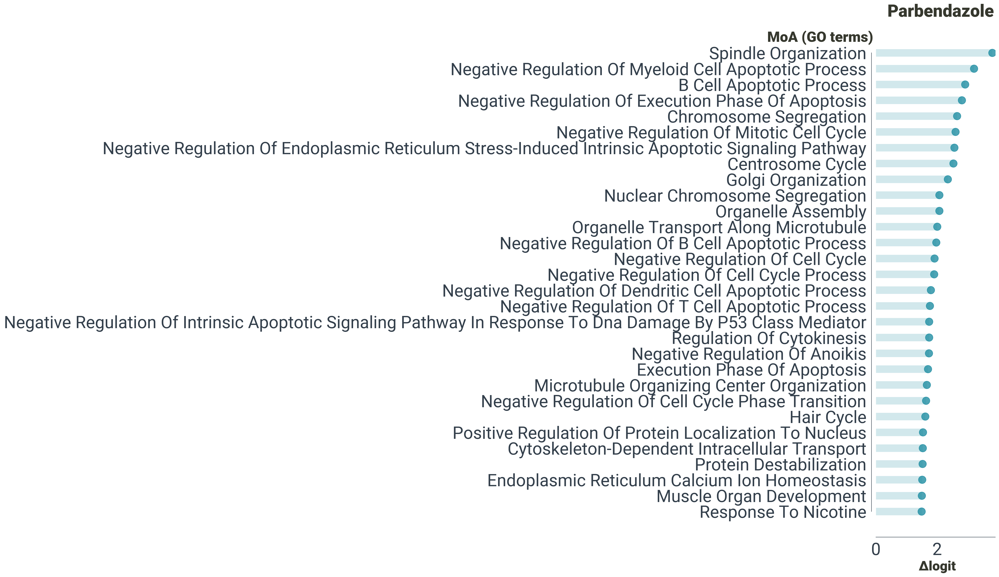

In [138]:
# import libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# set font
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = 'Roboto'

# set the style of the axes and the text color
plt.rcParams['axes.edgecolor']='#333F4B'
plt.rcParams['axes.linewidth']=0.8
plt.rcParams['xtick.color']='#333F4B'
plt.rcParams['ytick.color']='#333F4B'
plt.rcParams['text.color']='#333F4B'


# create some fake data
percentages = pd.Series(logits2, 
                        index=[s.title() for s in names2])
df = pd.DataFrame({'percentage' : percentages})
df = df.sort_values(by='percentage')

# we first need a numeric placeholder for the y axis
my_range=list(range(1,len(df.index)+1))

fig, ax = plt.subplots(figsize=(4,17))

# create for each expense type an horizontal line that starts at x = 0 with the length 
# represented by the specific value.
plt.hlines(y=my_range, xmin=0, xmax=df['percentage'], color='#208EA3', alpha=0.2, linewidth=14)

# create for each value type a dot at the level of the value
plt.plot(df['percentage'], my_range, "o", markersize=14, color='#208EA3', alpha=0.8)

# set labels
ax.set_xlabel(' Δlogit', fontsize=25, fontweight='black', color = '#36382E')
ax.set_ylabel('')
ax.set_facecolor(color="white")
ax.set_alpha(1)

# set axis
ax.tick_params(axis='both', which='major', labelsize=32)
plt.yticks(my_range, df.index)

# add an horizonal label for the y axis 
fig.text(-0.58, 0.862, 'MoA (GO terms)', fontsize=27, fontweight='black', color = '#36382E')
fig.text(0.2, 0.9, selected_drug_u_name.capitalize(), fontsize=32, fontweight='black', color = '#36382E')

# .upper() capitalize

# change the style of the axis spines
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.spines['left'].set_bounds((1, len(my_range)))
ax.set_xlim(0,max(logits2)+0.1)

ax.spines['left'].set_position(('outward', 8))
ax.spines['bottom'].set_position(('outward', 5))

plt.savefig(resultsdir+selected_drug_u_name+'_top_terms.png', dpi=300, bbox_inches='tight')

### For known drug... 

In [139]:
display(combobox)

interactive(children=(Combobox(value='regorafenib', description='drug', options=('regorafenib', 'vorinostat:na…

In [140]:
selected_drug_name = combobox.result

In [141]:
# LOS LOGITS DE TEST!!
train_drug_logs = pd.DataFrame(platt_matrix.loc[:,selected_drug_name]).reset_index()
train_drug_logs.columns  = ["GO_term","probability"]
train_drug_logs = train_drug_logs.merge(real_go_info_svm, on="GO_term")

In [142]:
train_drug_logs.loc[train_drug_logs["layer_number"] <=3].sort_values(by=["probability"], ascending=False).head(30)

,GO_term,probability,Name,layer_number
183,GO:0048608,0.742225,Reproductive structure development (1),3.0
381,GO:0048041,0.737675,Focal adhesion assembly (1),2.0
535,GO:0010628,0.646147,Positive regulation of gene expression (1),3.0
181,GO:0045137,0.645515,Development of primary sexual characteristics (1),3.0
329,GO:0006939,0.637615,Smooth muscle contraction (1),3.0
532,GO:0010557,0.628009,Positive regulation of macromolecule biosynthetic process (1),3.0
579,GO:0031328,0.620431,Positive regulation of cellular biosynthetic process (1),3.0
408,GO:0048008,0.615540,Platelet-derived growth factor receptor signaling pathway (1),1.0
502,GO:0008284,0.594571,Positive regulation of cell population proliferation (1),3.0
776,GO:0072593,0.591717,Reactive oxygen species metabolic process (1),3.0


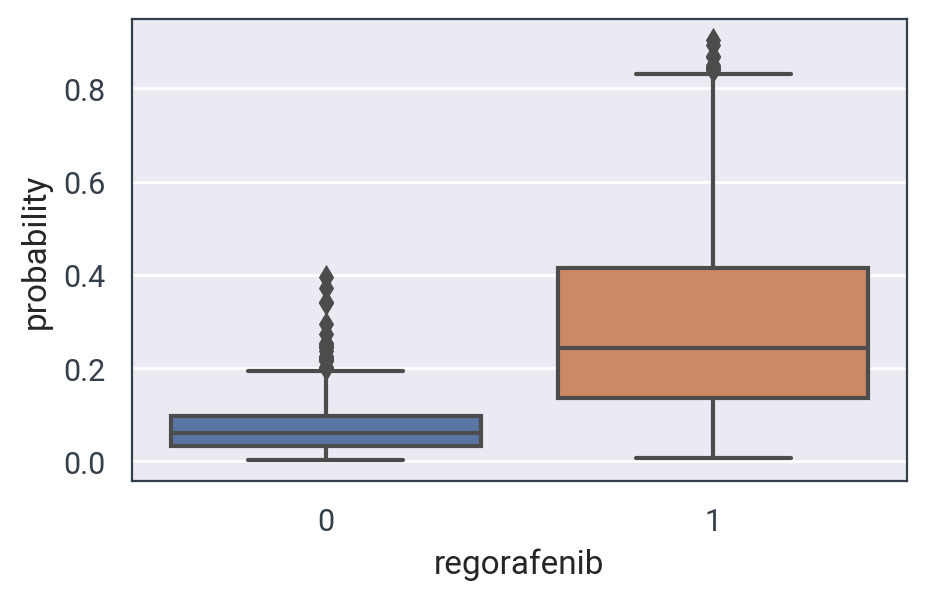

In [144]:
ax = sns.boxplot(x=slim_matrix_single_neuron.loc[train_drug_logs["GO_term"],selected_drug_name], y=train_drug_logs.set_index("GO_term")["probability"], data=plot,showfliers=True )

In [145]:
# same as before
sum_annotations = slim_matrix_single_neuron.T.sum()/slim_matrix_single_neuron.shape[1]
logits_apriori= np.log(sum_annotations/(1-sum_annotations))

In [146]:
logits_apost= np.log(train_drug_logs["probability"]/(1-train_drug_logs["probability"]))
delta_logits = logits_apost.to_numpy()-logits_apriori.to_numpy()
delta_logits_df = pd.DataFrame(delta_logits)
delta_logits_df.columns = ["delta_logits"]
train_drug_mod = train_drug_logs.merge(delta_logits_df, left_index=True,right_index=True)

In [147]:
train_drug_mod.loc[train_drug_mod["layer_number"] <=3].sort_values(by=["delta_logits"], ascending=False).head(30)

,GO_term,probability,Name,layer_number,delta_logits
329,GO:0006939,0.637615,Smooth muscle contraction (1),3.0,2.871769
381,GO:0048041,0.737675,Focal adhesion assembly (1),2.0,2.568268
144,GO:0002318,0.544781,Myeloid progenitor cell differentiation (1),0.0,2.533049
408,GO:0048008,0.615540,Platelet-derived growth factor receptor signaling pathway (1),1.0,2.529048
595,GO:0032526,0.508940,Response to retinoic acid (1),1.0,2.437785
183,GO:0048608,0.742225,Reproductive structure development (1),3.0,2.222701
458,GO:0048839,0.391941,Inner ear development (1),3.0,2.066365
793,GO:1901888,0.500000,Regulation of cell junction assembly (1),2.0,2.058388
956,GO:0002327,0.382026,Immature b cell differentiation (1),0.0,1.921062
192,GO:0003254,0.571930,Regulation of membrane depolarization (1),1.0,1.903704


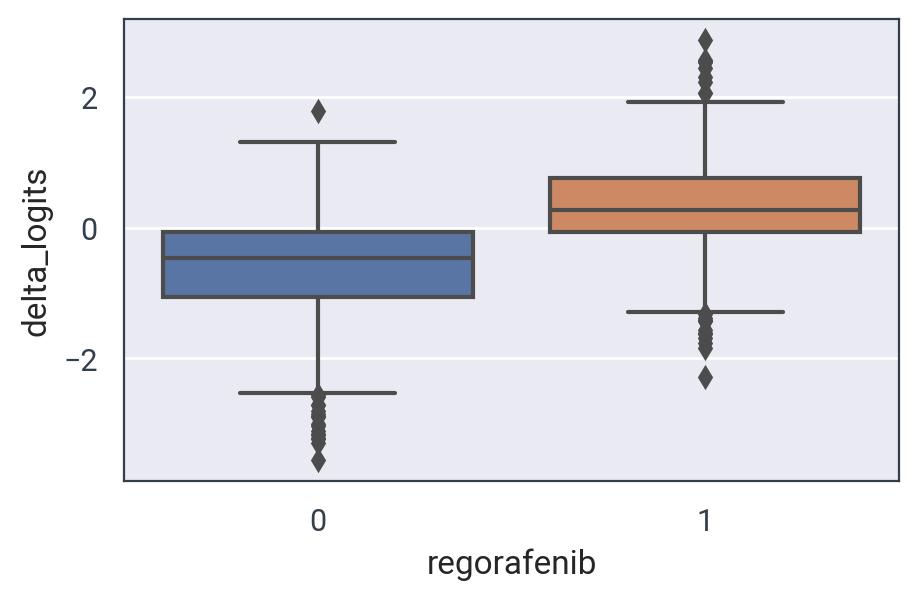

In [148]:
ax = sns.boxplot(x=slim_matrix_single_neuron.loc[train_drug_mod["GO_term"],selected_drug_name], y=train_drug_mod.set_index("GO_term")["delta_logits"], data=plot,showfliers=True)

## SVM GO TERM 2D representation

In [149]:
from sklearn.manifold import TSNE
import plotly.express as px

**Choose go to study...**

In [150]:
display(combobox_go)

interactive(children=(Combobox(value='GO:0044342', description='goterm', options=('GO:1901029', 'GO:0044342', …

In [151]:
selected_goterm = combobox_go.result

In [152]:
real_go_info[real_go_info["GO_term"]==selected_goterm+"_1"]

,GO_term,Name,layer_number
24,GO:0007051_1,Spindle organization (1),3.0


In [153]:
list_nodes = []
for i in range(1,7):
    list_nodes.append(selected_goterm+"_"+str(i))

score = attribution_data_annotated.loc[list_nodes].T
score_mod = score.divide(score.std()).fillna(0) 
annotations  =slim_matrix_single_neuron.loc[selected_goterm,]
y_predicted = models_svm[selected_goterm].predict(score_mod.astype(float))

### Plot SVM

#### View statistics of GOterm

*"Perfect" model (with train data)*

In [154]:
auc = metrics.roc_auc_score(annotations, models_svm[selected_goterm].decision_function(score_mod.astype(float)))
cnf_matrix = metrics.confusion_matrix(annotations,y_predicted)
print(cnf_matrix)

print("Accuracy:",metrics.accuracy_score(annotations, y_predicted))
print("Precision:",metrics.precision_score(annotations,y_predicted)) # TP / (TP+FP)
print("Recall:",metrics.recall_score(annotations, y_predicted)) #TP / (TP+FN)
print("AUC with score:",auc) 

[[227  19]
 [  3  16]]
Accuracy: 0.9169811320754717
Precision: 0.45714285714285713
Recall: 0.8421052631578947
AUC with score: 0.9531450577663672


TN  -  FP

FN  -  TP

En mi opinion interesa mucho el precision, prefiero que haya menos FP no??

*Test statistics...*

In [155]:
auc = metrics.roc_auc_score(slim_matrix_single_neuron.loc[selected_goterm],  platt_matrix.loc[selected_goterm])
cnf_matrix = metrics.confusion_matrix(slim_matrix_single_neuron.loc[selected_goterm], preds_svm_matrix.loc[selected_goterm])
print(cnf_matrix)

print("Accuracy:",metrics.accuracy_score(slim_matrix_single_neuron.loc[selected_goterm], preds_svm_matrix.loc[selected_goterm]))
print("Precision:",metrics.precision_score(slim_matrix_single_neuron.loc[selected_goterm], preds_svm_matrix.loc[selected_goterm]))
print("Recall:",metrics.recall_score(slim_matrix_single_neuron.loc[selected_goterm], preds_svm_matrix.loc[selected_goterm])) #TP / (TP+FN)
print("AUC with score:",auc) #TP / (TP+FN)

[[225  21]
 [  6  13]]
Accuracy: 0.8981132075471698
Precision: 0.38235294117647056
Recall: 0.6842105263157895
AUC with score: 0.891313649978605


In [157]:
import colorlover as cl
matrix = metrics.confusion_matrix(annotations,y_predicted)
tn, fp, fn, tp = matrix.ravel()

values = [tp, fn, fp, tn]
label_text = ["True Positive", "False Negative", "False Positive", "True Negative"]
labels = ["<b>TP</b>", "<b>FN</b>", "<b>FP</b>", "<b>TN</b>"]
blue = cl.flipper()["seq"]["9"]["Blues"]
red = cl.flipper()["seq"]["9"]["Reds"]
colors = ["#ff3700","#FFA0A0", "#CCE9FF",  "#0b8bff"]
trace0 = go.Pie(
    labels=label_text,
    values=values,
    hoverinfo="label+value+percent",
    textinfo="text+value",
    text=labels,
    sort=False,
    marker=dict(colors=colors),
    insidetextfont={"color": "#36382E"},
    rotation=90,
)

layout = go.Layout(
    title=dict(text="Confusion Matrix",
              x=0.3,
              y=0.8,
              font=dict(size=14),
              xanchor='center',
              yanchor='top'),
    #margin=dict(l=50, r=50, t=100, b=10),
    legend=dict(font={"color": "#36382E"}, orientation="h",x=0.1, y=-0.03),
#    plot_bgcolor="#282b38",
#    paper_bgcolor="#282b38",
    font=dict(family='Roboto',color= "#36382E"),
)

data = [trace0]
figure = go.Figure(data=data, layout=layout)
figure

In [158]:
y_test=annotations
decision_test=y_predicted
fpr, tpr, threshold = metrics.roc_curve(y_test, decision_test)

# AUC Score
auc_score = metrics.roc_auc_score(y_true=y_test, y_score=decision_test)

trace0 = go.Scatter(
    x=fpr, y=tpr, mode="lines", name="Test Data", marker={"color": "#ff3700"}
)

layout = go.Layout(
    title=dict(text=f"ROC Curve (AUC = {auc_score:.3f})",
            x=0.6,
            y=0.5,
            font=dict(size=20)
              ),
    xaxis=dict(title="False Positive Rate", gridcolor="white"),
    yaxis=dict(title="True Positive Rate", gridcolor="white"),
    legend=dict(x=0, y=1.05, orientation="h"),
    margin=dict(l=100, r=10, t=25, b=40),
#    plot_bgcolor="#282b38",
#    paper_bgcolor="#282b38",
    font=dict(family='Roboto',color= "#36382E"),
)

data = [trace0]
figure = go.Figure(data=data, layout=layout)
figure

#### Plot SVM with unknown labels

#####  Voronoi Tessellation

What is a Voronoi Tessellation? Given a set P := {p1, ..., pn} of sites, a Voronoi Tessellation is a subdivision of the space into n cells, one for each site in P, with the property that a point q lies in the cell corresponding to a site pi iff d(pi, q) < d(pj, q) for i distinct from j. The segments in a Voronoi Tessellation correspond to all points in the plane equidistant to the two nearest sites. Voronoi Tessellations have applications in computer science.

https://stackoverflow.com/questions/61225052/svm-plot-decision-surface-when-working-with-more-than-2-features

In [159]:
tsne = TSNE(n_components=2, verbose=0,
           init="pca",
            perplexity=30,
            random_state=123
           )
z = tsne.fit_transform(score_mod.astype(float)) 

In [160]:
list_nodes = list(models_svm[selected_goterm].feature_names_in_) # Extract the feature names from the model (those are the attributions we need)
score_unknown = attribution_data_all.loc[list_nodes,unknown].T
score_unknown_mod = score_unknown.divide(score.std()).fillna(0) # normalize

In [161]:
y_unknown = np.full(score_unknown_mod.shape[0],2) # 2=unknown MOA
y_pred_unknown = models_svm[selected_goterm].predict(score_unknown_mod.astype(float))

In [162]:
# join scores and annotations from known and unknown drugs
all_score = pd.concat([score_mod,score_unknown_mod])
all_y = np.concatenate((annotations,y_unknown))  # 2=unknown MOA

Plot T-SNE SVM

In [163]:
from sklearn.neighbors._classification import KNeighborsClassifier
# https://github.com/plotly/dash-sample-apps/blob/main/apps/dash-svm/utils/dash_reusable_components.py
z = tsne.fit_transform(all_score.astype(float)) 
df = pd.DataFrame()
df["y"] = all_y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
df["name"] =list(all_score.index)
df = df.sort_values(by=['y'])
df["y"] = df["y"].astype(str)
X,y = all_score.astype(float), all_y
y_predicted = models_svm[selected_goterm].predict(X)

resolution = 300 # 100x100 background pixels
X2d_xmin, X2d_xmax = np.min(z[:,0])-1, np.max(z[:,0])+1
X2d_ymin, X2d_ymax = np.min(z[:,1])-1, np.max(z[:,1])+1
xx, yy = np.meshgrid(np.linspace(X2d_xmin, X2d_xmax, resolution), np.linspace(X2d_ymin, X2d_ymax, resolution))

# approximate Voronoi tesselation on resolution x resolution grid using 1-NN
background_model = KNeighborsClassifier(n_neighbors=1).fit(z, y_predicted) 
voronoiBackground = background_model.predict(np.c_[xx.ravel(), yy.ravel()])
voronoiBackground = voronoiBackground.reshape((resolution, resolution))

In [164]:
go_name=real_go_info[real_go_info["GO_term"]==selected_goterm+"_1"]["Name"].values[0][:-4]
go_name

'Spindle organization'

In [165]:
bright_cscale = [[0, "#0b8bff"], [0.5, "#ff3700"],[1, "#36382E"]]
new_cscale = [[0, "#CCE9FF"], [1, "#FFA0A0"]]

trace0 = go.Contour(
        x=xx.flatten(),
        y=yy.flatten(),
        z=voronoiBackground.flatten(),
        hoverinfo="none",
        showscale=False,
        contours=dict(showlines=False),
        colorscale=new_cscale,
        opacity=0.9,
    )
    
trace1 = go.Contour(
    x=xx.flatten(),
    y=yy.flatten(),
    z=voronoiBackground.flatten(),
    showscale=False,
    hoverinfo="none",
    colorscale=new_cscale,
    line=dict(color="#ff3700"),
    )

trace2 = go.Scatter(
    x=df["comp-1"],
    y=df["comp-2"],
    mode="markers",
    text=df["name"].to_numpy(),
    marker=dict(size=7, color=df["y"].to_numpy(int),colorscale=bright_cscale),
    showlegend=False
)

legend1 = go.Scatter(
    x=[None],
    y=[None],
    mode="markers",
    name="Not annotated<br>to "+selected_goterm,
    marker=dict(size=7, color="#0b8bff",symbol='circle'),
)

legend2 = go.Scatter(
    x=[None],
    y=[None],
    mode="markers",
    name="Drug annotated<br>to "+selected_goterm,
    marker=dict(size=7, color="#ff3700",symbol='circle'),
)

legend3 = go.Scatter(
    x=[None],
    y=[None],
    mode="markers",
    name="Unknown MOA<br>annotations",
    marker=dict(size=7, color="#36382E",symbol='circle'),
)

    
layout = go.Layout(
   title=dict(text="<b>"+selected_goterm+"</b> "+go_name,
              x=0.5,
              y=0.92,
              font=dict(size=23),
              xanchor='center',
              yanchor='top'),
    xaxis=dict(ticks="", showticklabels=False, showgrid=False, zeroline=False),
    yaxis=dict(ticks="", showticklabels=False, showgrid=False, zeroline=False),
    yaxis_range=[min(yy.flatten()),max(yy.flatten())],
    xaxis_range=[min(xx.flatten()),max(xx.flatten())],
    legend=dict(x=0, y=0, orientation="h",font=dict(size=15)),
    paper_bgcolor='rgba(0,0,0,0)',
    width=600, height=800,
    font=dict(family='Roboto',color= "#36382E",size=15)
    )
data = [trace0,trace1,trace2,legend2,legend1,legend3]
figure = go.Figure(data=data,layout=layout)

figure

Add drugs

In [166]:
# Spindle organization
figure = go.Figure(data=data,layout=layout)
figure.add_annotation(
         x=df["comp-1"].loc[df["name"]=="sb-743921"].to_numpy()[0], y=df["comp-2"].loc[df["name"]=="sb-743921"].to_numpy()[0],
         xref="x", yref="y",
         text="<b>"+'SB-743921'"<b>",
         showarrow=True,
         font=dict(
            # family="Courier New, monospace",
             size=19,
             color="#000000"
             ),
         align="center",
         arrowhead=2,
         arrowsize=1,
         arrowwidth=2,
         arrowcolor="#636363",
         ax=-250,
         ay=-10,
         bordercolor="#636363",
         borderwidth=1,
         borderpad=4,
         bgcolor="#ffffff",
         opacity=0.8
         )

figure.add_annotation(
         x=df["comp-1"].loc[df["name"]=="thapsigargin"].to_numpy()[0], y=df["comp-2"].loc[df["name"]=="thapsigargin"].to_numpy()[0],
         xref="x", yref="y",
         text="<b>"+'Thapsigargin'"<b>",
         showarrow=True,
         font=dict(
            # family="Courier New, monospace",
             size=19,
             color="#000000"
             ),
         align="center",
         arrowhead=2,
         arrowsize=1,
         arrowwidth=2,
         arrowcolor="#636363",
         ax=-60,
         ay=-90,
         bordercolor="#636363",
         borderwidth=1,
         borderpad=4,
         bgcolor="#ffffff",
         opacity=0.8
         )

figure.add_annotation(
         x=df["comp-1"].loc[df["name"]=="triptolide"].to_numpy()[0], y=df["comp-2"].loc[df["name"]=="triptolide"].to_numpy()[0],
         xref="x", yref="y",
         text="<b>"+'Triptolide'"<b>",
         showarrow=True,
         font=dict(
            # family="Courier New, monospace",
             size=19,
             color="#000000"
             ),
         align="center",
         arrowhead=2,
         arrowsize=1,
         arrowwidth=2,
         arrowcolor="#636363",
         ax=-130,
         ay=-80,
         bordercolor="#636363",
         borderwidth=1,
         borderpad=4,
         bgcolor="#ffffff",
         opacity=0.8
         )

figure.add_annotation(
         x=df["comp-1"].loc[df["name"]=="gw843682x"].to_numpy()[0], y=df["comp-2"].loc[df["name"]=="gw843682x"].to_numpy()[0],
         xref="x", yref="y",
         text="<b>"+'GW843682X'"<b>",
         showarrow=True,
         font=dict(
            # family="Courier New, monospace",
             size=19,
             color="#000000"
             ),
         align="center",
         arrowhead=2,
         arrowsize=1,
         arrowwidth=2,
         arrowcolor="#636363",
         ax=-110,
         ay=70,
         bordercolor="#636363",
         borderwidth=1,
         borderpad=4,
         bgcolor="#ffffff",
         opacity=0.8
         )

# Top Genes

In [167]:
from captum.attr import LayerDeepLift, DeepLift

In [168]:
def get_compound_names(file_name):
    compounds = []

    with open(file_name, 'r') as fi:
        for line in fi:
            tokens = line.strip().split('\t')
            compounds.append([tokens[1],tokens[2]])
    return compounds

In [169]:
drugs = get_compound_names(inputdir+"compound_names.txt")
drugs.pop(0)

['SMILE', 'Name']

In [170]:
def f(drug):    
    return drug

In [171]:
num_neurons_per_GO = 6
median_cell_features = np.median(cell_features,axis=0) # to use as a reference
median_drug_features = np.genfromtxt(computer+"SparseGO_code/data/glucose_fingerprint.txt", delimiter=',')

In [172]:
def get_layer_attribution_genes(input_data,baseline,selected_drug_data):
    #dl = DeepLift(model,  multiply_by_inputs=True)  # CHOOSE LAYER TO STUDY
    dl = DeepLift(model) 
    dl_attr_test = dl.attribute(input_data,baseline)
    dl_attr_test_sum = dl_attr_test.cpu().detach().numpy().sum(0) # se suman las attributions para cada sample
    # dl_attr_test_norm_sum = dl_attr_test_sum / np.linalg.norm(dl_attr_test_sum, ord=1) # se normaliza 
    dl_attr_test_norm_sum = dl_attr_test_sum 

    # gene2id_mapping WAS USED TO CREATE THE FIRST LAYER OF THE NETWORK, SO THAT INPUT DATA MATCHES THE FIRST LAYER 
    attribution_data = pd.DataFrame(np.column_stack((np.array(list(gene2id_mapping.keys())),dl_attr_test_norm_sum[0:len(gene2id_mapping.keys())])), columns=["Gene",selected_drug_data[1]])
    attribution_data[[selected_drug_data[1]]] = attribution_data[[selected_drug_data[1]]].apply(pd.to_numeric).round(8)
    return attribution_data

In [ ]:
first = 1
# Obtain the top GO terms on all layers for each drug
for selected_drug_data in drugs:
    selected_drug =selected_drug_data[0] # DRUG smile
    selected_drug_features = []
    drug_specific_features=drug_features[drug2id_mapping[selected_drug]] # features of drug
    for i in range(len(cell2id_mapping)): # make all combinations of selected_drug and cell types 
        selected_drug_features.append(np.concatenate((cell_features[i], drug_specific_features), axis=None))
    selected_drug_features = torch.FloatTensor(np.array(selected_drug_features))

    # Data for deeplift
    input_data = torch.autograd.Variable(selected_drug_features.cuda(0))
    baseline = torch.FloatTensor(np.concatenate((median_cell_features, median_drug_features), axis=None))
    baseline = torch.reshape(baseline, (1, baseline.size()[0]))
    baseline = torch.autograd.Variable(baseline.cuda(0))
    
    
    attribution_data_drug = get_layer_attribution_genes(input_data,baseline,selected_drug_data)
    # top_scores = attribution_data_drug.nlargest(5, selected_drug_data[1]) # PROBAR TMB CON ABS VALUE
    # top_genes.loc[selected_drug_data[1]] = top_scores['Gene'].values # PERO IGUAL HABRIA QUE ELIMINAR ANTES LOS QUE TIENEN ALTO SCORE EN TODOS
        
    if first==1:
        attribution_data_all_genes = attribution_data_drug
        first=0
    else:
        attribution_data_all_genes = pd.concat([attribution_data_all_genes,attribution_data_drug.iloc[:,1]], axis=1)

    print(selected_drug_data[1])

In [ ]:
attribution_data_all_genes = attribution_data_all_genes.set_index("Gene")

In [176]:
top_var = attribution_data_all_genes.var(axis=1).sort_values(axis=0, ascending=False)[0:1000000] # Almost no change

In [177]:
attribution_data_all_genes_var = attribution_data_all_genes.loc[top_var.index.values]

In [178]:
attribution_data_all_genes_var.head()

,(-)-Parthenolide,(5Z)-7-Oxozeaenol,5-Fluorouracil,681640,A-443654,A-484954,A-770041,A-83-01,Acadesine,ACY-1215,...,Vemurafenib,VER-155008,Vorapaxar,vorinostat:carboplatin (1:1 mol/mol),vorinostat:navitoclax (4:1 mol/mol),VU0155056,WZ4002,WZ8040,YL54,Zebularine
Gene,,,,,,,,,,,,,,,,,,,,,
TNF,-0.647627,-1.171123,-0.798656,-1.056030,-1.482396,-0.351407,-1.223713,-0.432469,-0.355250,-1.175542,...,-0.150800,-0.713235,-0.225855,-0.834043,-1.694794,-0.321265,-0.451579,-0.623499,-0.315067,-0.188699
TLR4,0.424753,0.587436,0.552789,0.811383,1.290940,0.170548,0.649595,0.153363,0.155758,0.671745,...,0.261201,0.585952,0.462414,0.527991,0.756867,0.326152,0.669734,0.668688,0.348900,0.281724
CX3CL1,0.367396,0.850156,0.397639,0.463275,1.145052,0.093489,0.278140,0.087945,0.085774,0.503575,...,-0.033222,0.333330,0.384190,0.375685,0.785719,0.193030,0.303128,0.316458,0.240599,0.139607
NCKAP1L,-0.209777,-0.407460,-0.355179,-0.555746,-0.655136,-0.109196,-0.420126,-0.102194,-0.131356,-0.715699,...,-0.008355,-0.403133,-0.178399,-0.604647,-0.783917,-0.156935,-0.544116,-0.704079,-0.086063,-0.150185
VAV1,-0.113726,-0.504159,-0.213520,-0.656914,-0.371759,-0.107983,-0.040083,-0.144649,-0.099499,-0.107369,...,-0.077634,-0.122759,-0.110199,-0.115432,0.150526,-0.045423,0.037265,-0.052557,-0.074338,-0.039058


In [ ]:
attribution_data_all_genes_var.to_excel(resultsdir+'attribution_data_all_genes.xlsx', index=True)

In [179]:
top_genes = {}
num_genes = 50
# loop through each column in the dataframe
for col in attribution_data_all_genes_var.columns:
    
    # get the top n scores and their index (i.e., row name)
    top_scores = abs(attribution_data_all_genes_var[col]).nlargest(num_genes)
    top_scores_idx = top_scores.index
   
    top_genes[col] = top_scores_idx.values.tolist()
        # 'scores': top_scores.values.tolist(),


In [180]:
# create DataFrame from dictionary
df_top_genes = pd.DataFrame.from_dict(top_genes, orient='index')
df_top_genes.columns  = ['Gene{}'.format(i) for i in range(1, num_genes+1)]

In [181]:
df_top_genes.head(10)

,Gene1,Gene2,Gene3,Gene4,Gene5,Gene6,Gene7,Gene8,Gene9,Gene10,...,Gene41,Gene42,Gene43,Gene44,Gene45,Gene46,Gene47,Gene48,Gene49,Gene50
(-)-Parthenolide,TNF,TLR4,CX3CL1,ROR2,TBX1,WNT4,DRAXIN,BCL2,FOXB1,NKX2-5,...,HEY1,IL33,NCKAP1L,SLC7A3,NOTCH4,CCR7,IL24,ADAMTS20,RFLNA,ADORA1
(5Z)-7-Oxozeaenol,TNF,PTPRO,SFRP1,KCNE1,CX3CL1,SLC38A5,TBX1,SLCO2B1,RIPOR2,SFRP2,...,CAPN3,VAV1,GBP5,ABCB1,CLDN5,AIM2,ADAMTS20,TSPO2,RFLNA,IL2RG
5-Fluorouracil,TNF,TLR4,SLC38A5,TBX1,ROR2,WNT4,CX3CL1,DRAXIN,FOXB1,ANGPT1,...,PTPRO,CCL26,SFRP1,WNT9B,TLR2,KCNB1,PAK3,INHBB,CCL5,ZIC1
681640,TNF,TLR4,VAV1,PDGFRA,BCL2,LAPTM5,TBX1,IL2RG,ANGPT1,YAP1,...,CR1,SLCO2B1,PF4,WNT9B,AGTR1,IL23A,ADA2,SLFN11,JPH4,WNT4
A-443654,TNF,TLR4,TBX1,CX3CL1,DRAXIN,WNT4,FOXB1,PTPRO,SLC38A5,SFRP1,...,GHSR,HES5,IL2RG,ADD2,CLEC7A,RFLNA,SLCO2B1,ITGB3,FGF9,CCL26
A-484954,TNF,TLR4,SLC38A5,TBX1,DRAXIN,SFRP1,WNT4,LDHC,PIK3CG,FOXB1,...,ANXA1,AEBP1,ERBB2,IL33,LAPTM5,NOD2,HAMP,FUT7,TLR2,SLAMF8
A-770041,TNF,SLCO2B1,TLR4,PCSK9,WNT4,WNT3A,PTGS2,GJA1,SLC38A5,SYT12,...,GBP5,ROBO2,ACP5,SEMA3D,TNFRSF1B,MGARP,SERPINE1,IFNB1,FGF9,NR1H4
A-83-01,TNF,BTK,TBX1,SLC38A5,WNT4,CCL5,SPI1,FOXJ1,DRAXIN,TLR4,...,ADRA2A,PCSK9,DRD2,SLAMF8,IL12RB1,CCR2,CD300A,PTPRO,CD80,NTRK2
Acadesine,TNF,TBX1,TLR4,SLC38A5,WNT4,DRAXIN,PIK3CG,LDHC,SFRP1,NCKAP1L,...,ERBB2,HAMP,INHBB,SLAMF8,TWIST2,TNFSF18,SOX8,CHRNB2,CX3CL1,ITGB7
ACY-1215,TNF,NCKAP1L,TLR4,DRAXIN,TBX1,PTPRO,IL2RG,SFRP1,CCR7,YAP1,...,LHX3,GPR37L1,PAK3,CHRNB2,BHMG1,IL4,CRTAM,SOCS1,LAPTM5,SMOC2


In [ ]:
df_top_genes.to_excel(computer+'SparseGO_FirstPaper/First_Revision_eBioMedicine/Supplementary/top_genes_exp.xlsx', index=True)

### For a specific drug

In [174]:
combobox = interactive(f, drug=widgets.Combobox(options=list(attribution_data_all_genes.columns[1:])))

In [175]:
display(combobox)

interactive(children=(Combobox(value='', description='drug', options=('(5Z)-7-Oxozeaenol', '5-Fluorouracil', '…

In [184]:
selected_drug_name = combobox.result

In [183]:
selected_drug_attribution_gene = (attribution_data_all_genes_var.loc[:,selected_drug_name])

In [186]:
selected_drug_attribution_gene = selected_drug_attribution_gene.sort_values( ascending=False)

In [187]:
import plotly.graph_objects as go

# Assuming you have a list of gene scores for a given drug
gene_scores = selected_drug_attribution_gene.values[0:20]

# Create an array of x-coordinates
gene_names = selected_drug_attribution_gene.index[0:20]

# Define the color scale for the bars
color_scale = 'Blues'

# Create a bar plot using Plotly and assign the color scale
fig = go.Figure(data=go.Bar(x=gene_names, y=gene_scores, marker=dict(color=gene_scores, colorscale=color_scale)))

# Customize the plot layout
fig.update_layout(
    title="Top Gene Scores for " + selected_drug_name,
    xaxis_title="Gene",
    yaxis_title="Score",
    xaxis=dict(tickmode='linear'),
    yaxis=dict(range=[0, max(gene_scores)]),
    font=dict(family="Roboto"),
    # paper_bgcolor='rgba(0,0,0,0)',  # Transparent background
    # plot_bgcolor='rgba(0,0,0,0)'    # Transparent plot area
)

# Display the plot in a web-based environment
fig.show()